# Session (475165_f7_stage2_day1)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f7_stage2_day1" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f7"
day = "day1"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35861, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


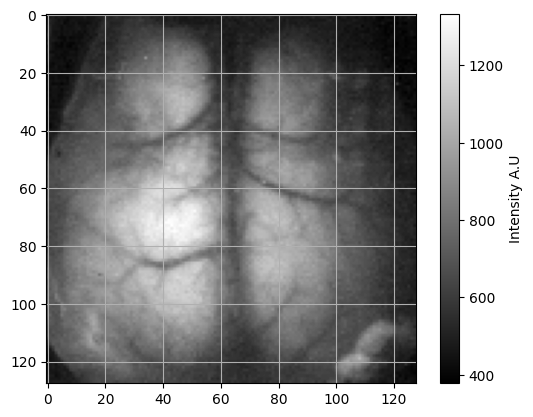

frame number 6000 plotted


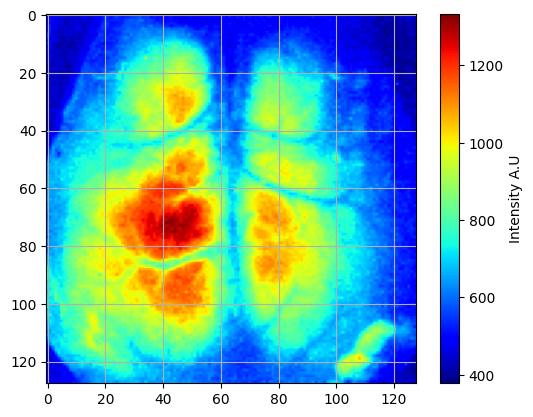

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 454.537353515625 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 511.3545227050781


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 100
Number of double_flash pairs: 50
Number of single_flash: 37
Number of total flashes: 137


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/137 [00:00<?, ?it/s]

  1%|▌                                                                                 | 1/137 [00:01<03:03,  1.35s/it]

  1%|█▏                                                                                | 2/137 [00:02<02:49,  1.26s/it]

  2%|█▊                                                                                | 3/137 [00:03<02:43,  1.22s/it]

  3%|██▍                                                                               | 4/137 [00:04<02:45,  1.24s/it]

  4%|██▉                                                                               | 5/137 [00:06<02:48,  1.28s/it]

  4%|███▌                                                                              | 6/137 [00:07<02:53,  1.33s/it]

  5%|████▏                                                                             | 7/137 [00:09<02:50,  1.31s/it]

  6%|████▊                                                                             | 8/137 [00:10<02:48,  1.31s/it]

  7%|█████▍                                                                            | 9/137 [00:11<02:44,  1.29s/it]

  7%|█████▉                                                                           | 10/137 [00:12<02:40,  1.27s/it]

  8%|██████▌                                                                          | 11/137 [00:14<02:44,  1.31s/it]

  9%|███████                                                                          | 12/137 [00:15<02:38,  1.27s/it]

  9%|███████▋                                                                         | 13/137 [00:16<02:38,  1.28s/it]

 10%|████████▎                                                                        | 14/137 [00:18<02:43,  1.33s/it]

 11%|████████▊                                                                        | 15/137 [00:19<02:43,  1.34s/it]

 12%|█████████▍                                                                       | 16/137 [00:20<02:40,  1.33s/it]

 12%|██████████                                                                       | 17/137 [00:22<02:40,  1.34s/it]

 13%|██████████▋                                                                      | 18/137 [00:23<02:38,  1.34s/it]

 14%|███████████▏                                                                     | 19/137 [00:24<02:37,  1.34s/it]

 15%|███████████▊                                                                     | 20/137 [00:26<02:37,  1.35s/it]

 15%|████████████▍                                                                    | 21/137 [00:27<02:37,  1.36s/it]

 16%|█████████████                                                                    | 22/137 [00:28<02:34,  1.34s/it]

 17%|█████████████▌                                                                   | 23/137 [00:30<02:32,  1.34s/it]

 18%|██████████████▏                                                                  | 24/137 [00:31<02:32,  1.35s/it]

 18%|██████████████▊                                                                  | 25/137 [00:32<02:31,  1.35s/it]

 19%|███████████████▎                                                                 | 26/137 [00:34<02:24,  1.30s/it]

 20%|███████████████▉                                                                 | 27/137 [00:35<02:25,  1.32s/it]

 20%|████████████████▌                                                                | 28/137 [00:36<02:23,  1.31s/it]

 21%|█████████████████▏                                                               | 29/137 [00:38<02:22,  1.32s/it]

 22%|█████████████████▋                                                               | 30/137 [00:39<02:24,  1.35s/it]

 23%|██████████████████▎                                                              | 31/137 [00:40<02:23,  1.35s/it]

 23%|██████████████████▉                                                              | 32/137 [00:42<02:18,  1.32s/it]

 24%|███████████████████▌                                                             | 33/137 [00:43<02:17,  1.32s/it]

 25%|████████████████████                                                             | 34/137 [00:44<02:15,  1.31s/it]

 26%|████████████████████▋                                                            | 35/137 [00:46<02:13,  1.31s/it]

 26%|█████████████████████▎                                                           | 36/137 [00:47<02:11,  1.30s/it]

 27%|█████████████████████▉                                                           | 37/137 [00:48<02:10,  1.31s/it]

 28%|██████████████████████▍                                                          | 38/137 [00:49<02:08,  1.30s/it]

 28%|███████████████████████                                                          | 39/137 [00:51<02:08,  1.31s/it]

 29%|███████████████████████▋                                                         | 40/137 [00:52<02:06,  1.31s/it]

 30%|████████████████████████▏                                                        | 41/137 [00:53<02:03,  1.29s/it]

 31%|████████████████████████▊                                                        | 42/137 [00:55<02:03,  1.30s/it]

 31%|█████████████████████████▍                                                       | 43/137 [00:56<02:03,  1.31s/it]

 32%|██████████████████████████                                                       | 44/137 [00:57<01:59,  1.28s/it]

 33%|██████████████████████████▌                                                      | 45/137 [00:59<01:58,  1.29s/it]

 34%|███████████████████████████▏                                                     | 46/137 [01:00<01:59,  1.31s/it]

 34%|███████████████████████████▊                                                     | 47/137 [01:01<02:01,  1.35s/it]

 35%|████████████████████████████▍                                                    | 48/137 [01:03<02:03,  1.39s/it]

 36%|████████████████████████████▉                                                    | 49/137 [01:04<02:01,  1.38s/it]

 36%|█████████████████████████████▌                                                   | 50/137 [01:05<01:58,  1.36s/it]

 37%|██████████████████████████████▏                                                  | 51/137 [01:07<01:57,  1.36s/it]

 38%|██████████████████████████████▋                                                  | 52/137 [01:08<01:53,  1.33s/it]

 39%|███████████████████████████████▎                                                 | 53/137 [01:09<01:49,  1.31s/it]

 39%|███████████████████████████████▉                                                 | 54/137 [01:11<01:48,  1.31s/it]

 40%|████████████████████████████████▌                                                | 55/137 [01:12<01:49,  1.34s/it]

 41%|█████████████████████████████████                                                | 56/137 [01:13<01:46,  1.32s/it]

 42%|█████████████████████████████████▋                                               | 57/137 [01:15<01:45,  1.31s/it]

 42%|██████████████████████████████████▎                                              | 58/137 [01:16<01:43,  1.31s/it]

 43%|██████████████████████████████████▉                                              | 59/137 [01:17<01:43,  1.32s/it]

 44%|███████████████████████████████████▍                                             | 60/137 [01:19<01:42,  1.33s/it]

 45%|████████████████████████████████████                                             | 61/137 [01:20<01:43,  1.36s/it]

 45%|████████████████████████████████████▋                                            | 62/137 [01:21<01:40,  1.35s/it]

 46%|█████████████████████████████████████▏                                           | 63/137 [01:23<01:38,  1.34s/it]

 47%|█████████████████████████████████████▊                                           | 64/137 [01:24<01:36,  1.33s/it]

 47%|██████████████████████████████████████▍                                          | 65/137 [01:25<01:33,  1.30s/it]

 48%|███████████████████████████████████████                                          | 66/137 [01:26<01:30,  1.28s/it]

 49%|███████████████████████████████████████▌                                         | 67/137 [01:28<01:29,  1.28s/it]

 50%|████████████████████████████████████████▏                                        | 68/137 [01:29<01:28,  1.28s/it]

 50%|████████████████████████████████████████▊                                        | 69/137 [01:30<01:30,  1.33s/it]

 51%|█████████████████████████████████████████▍                                       | 70/137 [01:32<01:29,  1.34s/it]

 52%|█████████████████████████████████████████▉                                       | 71/137 [01:33<01:28,  1.34s/it]

 53%|██████████████████████████████████████████▌                                      | 72/137 [01:34<01:26,  1.33s/it]

 53%|███████████████████████████████████████████▏                                     | 73/137 [01:36<01:22,  1.30s/it]

 54%|███████████████████████████████████████████▊                                     | 74/137 [01:37<01:20,  1.28s/it]

 55%|████████████████████████████████████████████▎                                    | 75/137 [01:38<01:18,  1.26s/it]

 55%|████████████████████████████████████████████▉                                    | 76/137 [01:39<01:15,  1.24s/it]

 56%|█████████████████████████████████████████████▌                                   | 77/137 [01:41<01:14,  1.25s/it]

 57%|██████████████████████████████████████████████                                   | 78/137 [01:42<01:13,  1.25s/it]

 58%|██████████████████████████████████████████████▋                                  | 79/137 [01:43<01:12,  1.26s/it]

 58%|███████████████████████████████████████████████▎                                 | 80/137 [01:44<01:12,  1.28s/it]

 59%|███████████████████████████████████████████████▉                                 | 81/137 [01:46<01:10,  1.26s/it]

 60%|████████████████████████████████████████████████▍                                | 82/137 [01:47<01:09,  1.27s/it]

 61%|█████████████████████████████████████████████████                                | 83/137 [01:48<01:09,  1.29s/it]

 61%|█████████████████████████████████████████████████▋                               | 84/137 [01:50<01:09,  1.31s/it]

 62%|██████████████████████████████████████████████████▎                              | 85/137 [01:51<01:08,  1.31s/it]

 63%|██████████████████████████████████████████████████▊                              | 86/137 [01:52<01:06,  1.30s/it]

 64%|███████████████████████████████████████████████████▍                             | 87/137 [01:53<01:03,  1.27s/it]

 64%|████████████████████████████████████████████████████                             | 88/137 [01:55<01:00,  1.24s/it]

 65%|████████████████████████████████████████████████████▌                            | 89/137 [01:56<01:02,  1.30s/it]

 66%|█████████████████████████████████████████████████████▏                           | 90/137 [01:57<01:01,  1.31s/it]

 66%|█████████████████████████████████████████████████████▊                           | 91/137 [01:59<00:58,  1.27s/it]

 67%|██████████████████████████████████████████████████████▍                          | 92/137 [02:00<00:56,  1.25s/it]

 68%|██████████████████████████████████████████████████████▉                          | 93/137 [02:01<00:54,  1.23s/it]

 69%|███████████████████████████████████████████████████████▌                         | 94/137 [02:02<00:54,  1.26s/it]

 69%|████████████████████████████████████████████████████████▏                        | 95/137 [02:04<00:54,  1.31s/it]

 70%|████████████████████████████████████████████████████████▊                        | 96/137 [02:05<00:52,  1.28s/it]

 71%|█████████████████████████████████████████████████████████▎                       | 97/137 [02:06<00:50,  1.27s/it]

 72%|█████████████████████████████████████████████████████████▉                       | 98/137 [02:08<00:50,  1.29s/it]

 72%|██████████████████████████████████████████████████████████▌                      | 99/137 [02:09<00:49,  1.30s/it]

 73%|██████████████████████████████████████████████████████████▍                     | 100/137 [02:10<00:48,  1.32s/it]

 74%|██████████████████████████████████████████████████████████▉                     | 101/137 [02:12<00:47,  1.32s/it]

 74%|███████████████████████████████████████████████████████████▌                    | 102/137 [02:13<00:45,  1.31s/it]

 75%|████████████████████████████████████████████████████████████▏                   | 103/137 [02:14<00:44,  1.32s/it]

 76%|████████████████████████████████████████████████████████████▋                   | 104/137 [02:15<00:42,  1.30s/it]

 77%|█████████████████████████████████████████████████████████████▎                  | 105/137 [02:17<00:41,  1.30s/it]

 77%|█████████████████████████████████████████████████████████████▉                  | 106/137 [02:18<00:41,  1.33s/it]

 78%|██████████████████████████████████████████████████████████████▍                 | 107/137 [02:19<00:40,  1.35s/it]

 79%|███████████████████████████████████████████████████████████████                 | 108/137 [02:21<00:38,  1.34s/it]

 80%|███████████████████████████████████████████████████████████████▋                | 109/137 [02:22<00:37,  1.36s/it]

 80%|████████████████████████████████████████████████████████████████▏               | 110/137 [02:23<00:35,  1.32s/it]

 81%|████████████████████████████████████████████████████████████████▊               | 111/137 [02:25<00:33,  1.30s/it]

 82%|█████████████████████████████████████████████████████████████████▍              | 112/137 [02:26<00:33,  1.34s/it]

 82%|█████████████████████████████████████████████████████████████████▉              | 113/137 [02:27<00:31,  1.32s/it]

 83%|██████████████████████████████████████████████████████████████████▌             | 114/137 [02:29<00:29,  1.28s/it]

 84%|███████████████████████████████████████████████████████████████████▏            | 115/137 [02:30<00:28,  1.29s/it]

 85%|███████████████████████████████████████████████████████████████████▋            | 116/137 [02:31<00:27,  1.31s/it]

 85%|████████████████████████████████████████████████████████████████████▎           | 117/137 [02:33<00:26,  1.34s/it]

 86%|████████████████████████████████████████████████████████████████████▉           | 118/137 [02:34<00:25,  1.34s/it]

 87%|█████████████████████████████████████████████████████████████████████▍          | 119/137 [02:35<00:24,  1.36s/it]

 88%|██████████████████████████████████████████████████████████████████████          | 120/137 [02:37<00:22,  1.35s/it]

 88%|██████████████████████████████████████████████████████████████████████▋         | 121/137 [02:38<00:21,  1.34s/it]

 89%|███████████████████████████████████████████████████████████████████████▏        | 122/137 [02:39<00:19,  1.33s/it]

 90%|███████████████████████████████████████████████████████████████████████▊        | 123/137 [02:41<00:18,  1.32s/it]

 91%|████████████████████████████████████████████████████████████████████████▍       | 124/137 [02:42<00:17,  1.31s/it]

 91%|████████████████████████████████████████████████████████████████████████▉       | 125/137 [02:43<00:15,  1.31s/it]

 92%|█████████████████████████████████████████████████████████████████████████▌      | 126/137 [02:45<00:14,  1.30s/it]

 93%|██████████████████████████████████████████████████████████████████████████▏     | 127/137 [02:46<00:12,  1.28s/it]

 93%|██████████████████████████████████████████████████████████████████████████▋     | 128/137 [02:47<00:11,  1.27s/it]

 94%|███████████████████████████████████████████████████████████████████████████▎    | 129/137 [02:48<00:10,  1.29s/it]

 95%|███████████████████████████████████████████████████████████████████████████▉    | 130/137 [02:50<00:09,  1.29s/it]

 96%|████████████████████████████████████████████████████████████████████████████▍   | 131/137 [02:51<00:08,  1.34s/it]

 96%|█████████████████████████████████████████████████████████████████████████████   | 132/137 [02:52<00:06,  1.34s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▋  | 133/137 [02:54<00:05,  1.33s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 134/137 [02:55<00:03,  1.30s/it]

 99%|██████████████████████████████████████████████████████████████████████████████▊ | 135/137 [02:56<00:02,  1.30s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 136/137 [02:58<00:01,  1.30s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 137/137 [02:59<00:00,  1.29s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 137/137 [02:59<00:00,  1.31s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 23%|██████████████████▏                                                             | 29/128 [00:00<00:00, 287.23it/s]

 47%|█████████████████████████████████████▌                                          | 60/128 [00:00<00:00, 297.15it/s]

 70%|████████████████████████████████████████████████████████▎                       | 90/128 [00:00<00:00, 284.33it/s]

 93%|█████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:00<00:00, 249.45it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 253.56it/s]

  0%|                                                                                        | 0/34584 [00:00<?, ?it/s]

  0%|                                                                              | 28/34584 [00:00<02:04, 277.33it/s]

  0%|▏                                                                             | 56/34584 [00:00<02:06, 272.56it/s]

  0%|▏                                                                             | 84/34584 [00:00<02:05, 274.72it/s]

  0%|▎                                                                            | 114/34584 [00:00<02:01, 283.52it/s]

  0%|▎                                                                            | 144/34584 [00:00<01:59, 288.41it/s]

  1%|▍                                                                            | 175/34584 [00:00<01:57, 292.77it/s]

  1%|▍                                                                            | 205/34584 [00:00<02:02, 280.64it/s]

  1%|▌                                                                            | 234/34584 [00:00<02:02, 280.11it/s]

  1%|▌                                                                            | 263/34584 [00:00<02:08, 267.05it/s]

  1%|▋                                                                            | 290/34584 [00:01<02:13, 256.11it/s]

  1%|▋                                                                            | 321/34584 [00:01<02:06, 269.85it/s]

  1%|▊                                                                            | 352/34584 [00:01<02:02, 278.98it/s]

  1%|▊                                                                            | 381/34584 [00:01<02:15, 251.94it/s]

  1%|▉                                                                            | 407/34584 [00:01<02:17, 248.39it/s]

  1%|▉                                                                            | 435/34584 [00:01<02:14, 254.66it/s]

  1%|█                                                                            | 461/34584 [00:01<02:15, 251.96it/s]

  1%|█                                                                            | 492/34584 [00:01<02:08, 266.08it/s]

  2%|█▏                                                                           | 523/34584 [00:01<02:02, 277.05it/s]

  2%|█▏                                                                           | 553/34584 [00:02<02:00, 282.88it/s]

  2%|█▎                                                                           | 582/34584 [00:02<02:08, 264.22it/s]

  2%|█▎                                                                           | 610/34584 [00:02<02:07, 266.42it/s]

  2%|█▍                                                                           | 637/34584 [00:02<02:09, 263.00it/s]

  2%|█▍                                                                           | 667/34584 [00:02<02:04, 272.77it/s]

  2%|█▌                                                                           | 695/34584 [00:02<02:11, 258.49it/s]

  2%|█▌                                                                           | 722/34584 [00:02<02:13, 253.25it/s]

  2%|█▋                                                                           | 748/34584 [00:02<02:18, 243.63it/s]

  2%|█▋                                                                           | 776/34584 [00:02<02:14, 252.28it/s]

  2%|█▊                                                                           | 804/34584 [00:03<02:10, 258.64it/s]

  2%|█▊                                                                           | 831/34584 [00:03<02:11, 256.78it/s]

  2%|█▉                                                                           | 859/34584 [00:03<02:08, 261.95it/s]

  3%|█▉                                                                           | 887/34584 [00:03<02:07, 264.14it/s]

  3%|██                                                                           | 915/34584 [00:03<02:07, 263.42it/s]

  3%|██                                                                           | 942/34584 [00:03<02:08, 262.32it/s]

  3%|██▏                                                                          | 969/34584 [00:03<02:09, 258.58it/s]

  3%|██▏                                                                          | 997/34584 [00:03<02:09, 258.82it/s]

  3%|██▏                                                                         | 1023/34584 [00:03<02:15, 247.14it/s]

  3%|██▎                                                                         | 1049/34584 [00:03<02:14, 250.08it/s]

  3%|██▎                                                                         | 1077/34584 [00:04<02:10, 256.46it/s]

  3%|██▍                                                                         | 1103/34584 [00:04<02:10, 256.03it/s]

  3%|██▍                                                                         | 1131/34584 [00:04<02:07, 262.26it/s]

  3%|██▌                                                                         | 1158/34584 [00:04<02:13, 249.62it/s]

  3%|██▌                                                                         | 1184/34584 [00:04<02:12, 251.16it/s]

  3%|██▋                                                                         | 1210/34584 [00:04<02:12, 252.28it/s]

  4%|██▋                                                                         | 1238/34584 [00:04<02:08, 259.58it/s]

  4%|██▊                                                                         | 1267/34584 [00:04<02:04, 267.12it/s]

  4%|██▊                                                                         | 1294/34584 [00:04<02:12, 251.76it/s]

  4%|██▉                                                                         | 1322/34584 [00:05<02:08, 259.28it/s]

  4%|██▉                                                                         | 1352/34584 [00:05<02:03, 268.68it/s]

  4%|███                                                                         | 1380/34584 [00:05<02:03, 268.11it/s]

  4%|███                                                                         | 1410/34584 [00:05<02:00, 275.77it/s]

  4%|███▏                                                                        | 1440/34584 [00:05<01:58, 280.41it/s]

  4%|███▏                                                                        | 1469/34584 [00:05<01:57, 280.78it/s]

  4%|███▎                                                                        | 1499/34584 [00:05<01:57, 280.69it/s]

  4%|███▎                                                                        | 1528/34584 [00:05<02:07, 259.31it/s]

  5%|███▍                                                                        | 1557/34584 [00:05<02:04, 266.32it/s]

  5%|███▍                                                                        | 1587/34584 [00:06<02:00, 273.51it/s]

  5%|███▌                                                                        | 1615/34584 [00:06<02:06, 260.55it/s]

  5%|███▌                                                                        | 1642/34584 [00:06<02:06, 260.31it/s]

  5%|███▋                                                                        | 1670/34584 [00:06<02:05, 262.92it/s]

  5%|███▋                                                                        | 1697/34584 [00:06<02:10, 251.36it/s]

  5%|███▊                                                                        | 1723/34584 [00:06<02:11, 249.62it/s]

  5%|███▊                                                                        | 1749/34584 [00:06<02:14, 244.32it/s]

  5%|███▉                                                                        | 1775/34584 [00:06<02:13, 246.67it/s]

  5%|███▉                                                                        | 1801/34584 [00:06<02:11, 249.06it/s]

  5%|████                                                                        | 1831/34584 [00:06<02:04, 262.23it/s]

  5%|████                                                                        | 1861/34584 [00:07<02:00, 271.64it/s]

  5%|████▏                                                                       | 1889/34584 [00:07<02:08, 254.10it/s]

  6%|████▏                                                                       | 1915/34584 [00:07<02:21, 230.14it/s]

  6%|████▎                                                                       | 1939/34584 [00:07<02:22, 229.66it/s]

  6%|████▎                                                                       | 1969/34584 [00:07<02:11, 247.13it/s]

  6%|████▍                                                                       | 1995/34584 [00:07<02:11, 248.66it/s]

  6%|████▍                                                                       | 2021/34584 [00:07<02:15, 239.70it/s]

  6%|████▍                                                                       | 2046/34584 [00:07<02:17, 236.68it/s]

  6%|████▌                                                                       | 2074/34584 [00:07<02:11, 248.09it/s]

  6%|████▌                                                                       | 2103/34584 [00:08<02:05, 257.84it/s]

  6%|████▋                                                                       | 2131/34584 [00:08<02:04, 260.49it/s]

  6%|████▋                                                                       | 2159/34584 [00:08<02:02, 265.37it/s]

  6%|████▊                                                                       | 2186/34584 [00:08<02:09, 250.71it/s]

  6%|████▊                                                                       | 2215/34584 [00:08<02:04, 261.04it/s]

  6%|████▉                                                                       | 2242/34584 [00:08<02:04, 259.91it/s]

  7%|████▉                                                                       | 2270/34584 [00:08<02:01, 264.95it/s]

  7%|█████                                                                       | 2299/34584 [00:08<01:59, 269.12it/s]

  7%|█████                                                                       | 2328/34584 [00:08<01:58, 272.84it/s]

  7%|█████▏                                                                      | 2356/34584 [00:09<01:57, 273.37it/s]

  7%|█████▏                                                                      | 2384/34584 [00:09<01:57, 273.74it/s]

  7%|█████▎                                                                      | 2412/34584 [00:09<01:58, 272.41it/s]

  7%|█████▎                                                                      | 2440/34584 [00:09<02:03, 260.89it/s]

  7%|█████▍                                                                      | 2467/34584 [00:09<02:03, 259.82it/s]

  7%|█████▍                                                                      | 2494/34584 [00:09<02:03, 259.79it/s]

  7%|█████▌                                                                      | 2521/34584 [00:09<02:11, 243.16it/s]

  7%|█████▌                                                                      | 2550/34584 [00:09<02:05, 254.69it/s]

  7%|█████▋                                                                      | 2580/34584 [00:09<02:00, 265.98it/s]

  8%|█████▋                                                                      | 2610/34584 [00:09<01:56, 273.38it/s]

  8%|█████▊                                                                      | 2639/34584 [00:10<01:56, 275.03it/s]

  8%|█████▊                                                                      | 2667/34584 [00:10<02:05, 253.75it/s]

  8%|█████▉                                                                      | 2693/34584 [00:10<02:08, 248.00it/s]

  8%|█████▉                                                                      | 2719/34584 [00:10<02:07, 249.96it/s]

  8%|██████                                                                      | 2748/34584 [00:10<02:02, 259.08it/s]

  8%|██████                                                                      | 2775/34584 [00:10<02:05, 253.93it/s]

  8%|██████▏                                                                     | 2801/34584 [00:10<02:09, 244.60it/s]

  8%|██████▏                                                                     | 2826/34584 [00:10<02:13, 238.16it/s]

  8%|██████▎                                                                     | 2854/34584 [00:10<02:08, 246.40it/s]

  8%|██████▎                                                                     | 2879/34584 [00:11<02:13, 236.77it/s]

  8%|██████▍                                                                     | 2903/34584 [00:11<02:14, 235.08it/s]

  8%|██████▍                                                                     | 2932/34584 [00:11<02:07, 248.49it/s]

  9%|██████▌                                                                     | 2962/34584 [00:11<02:01, 260.99it/s]

  9%|██████▌                                                                     | 2990/34584 [00:11<01:59, 264.97it/s]

  9%|██████▋                                                                     | 3020/34584 [00:11<01:55, 272.79it/s]

  9%|██████▋                                                                     | 3048/34584 [00:11<02:03, 254.88it/s]

  9%|██████▊                                                                     | 3074/34584 [00:11<02:08, 246.05it/s]

  9%|██████▊                                                                     | 3101/34584 [00:11<02:05, 251.31it/s]

  9%|██████▊                                                                     | 3128/34584 [00:12<02:03, 253.74it/s]

  9%|██████▉                                                                     | 3154/34584 [00:12<02:05, 250.56it/s]

  9%|██████▉                                                                     | 3180/34584 [00:12<02:05, 250.42it/s]

  9%|███████                                                                     | 3206/34584 [00:12<02:06, 247.51it/s]

  9%|███████                                                                     | 3235/34584 [00:12<02:02, 256.76it/s]

  9%|███████▏                                                                    | 3262/34584 [00:12<02:00, 259.11it/s]

 10%|███████▏                                                                    | 3290/34584 [00:12<01:58, 263.67it/s]

 10%|███████▎                                                                    | 3317/34584 [00:12<01:58, 264.78it/s]

 10%|███████▎                                                                    | 3346/34584 [00:12<01:56, 269.05it/s]

 10%|███████▍                                                                    | 3374/34584 [00:13<01:55, 270.71it/s]

 10%|███████▍                                                                    | 3403/34584 [00:13<01:53, 274.79it/s]

 10%|███████▌                                                                    | 3432/34584 [00:13<01:53, 275.25it/s]

 10%|███████▌                                                                    | 3460/34584 [00:13<01:57, 265.02it/s]

 10%|███████▋                                                                    | 3487/34584 [00:13<02:00, 259.06it/s]

 10%|███████▋                                                                    | 3517/34584 [00:13<01:55, 268.36it/s]

 10%|███████▊                                                                    | 3547/34584 [00:13<01:52, 274.87it/s]

 10%|███████▊                                                                    | 3577/34584 [00:13<01:50, 279.74it/s]

 10%|███████▉                                                                    | 3606/34584 [00:13<01:51, 277.91it/s]

 11%|███████▉                                                                    | 3636/34584 [00:13<01:49, 281.89it/s]

 11%|████████                                                                    | 3665/34584 [00:14<01:53, 273.15it/s]

 11%|████████                                                                    | 3695/34584 [00:14<01:51, 276.12it/s]

 11%|████████▏                                                                   | 3723/34584 [00:14<01:53, 271.05it/s]

 11%|████████▏                                                                   | 3751/34584 [00:14<02:00, 256.09it/s]

 11%|████████▎                                                                   | 3777/34584 [00:14<02:01, 254.39it/s]

 11%|████████▎                                                                   | 3806/34584 [00:14<01:57, 261.48it/s]

 11%|████████▍                                                                   | 3836/34584 [00:14<01:53, 270.91it/s]

 11%|████████▍                                                                   | 3864/34584 [00:14<01:55, 265.91it/s]

 11%|████████▌                                                                   | 3893/34584 [00:14<01:53, 270.43it/s]

 11%|████████▌                                                                   | 3921/34584 [00:15<01:56, 263.43it/s]

 11%|████████▋                                                                   | 3948/34584 [00:15<01:58, 259.43it/s]

 11%|████████▋                                                                   | 3975/34584 [00:15<01:57, 260.98it/s]

 12%|████████▊                                                                   | 4002/34584 [00:15<01:56, 262.09it/s]

 12%|████████▊                                                                   | 4030/34584 [00:15<01:54, 265.77it/s]

 12%|████████▉                                                                   | 4057/34584 [00:15<01:57, 260.20it/s]

 12%|████████▉                                                                   | 4084/34584 [00:15<01:59, 254.96it/s]

 12%|█████████                                                                   | 4110/34584 [00:15<02:06, 240.62it/s]

 12%|█████████                                                                   | 4138/34584 [00:15<02:02, 248.12it/s]

 12%|█████████▏                                                                  | 4163/34584 [00:16<02:04, 245.23it/s]

 12%|█████████▏                                                                  | 4193/34584 [00:16<01:57, 258.58it/s]

 12%|█████████▎                                                                  | 4219/34584 [00:16<02:06, 240.42it/s]

 12%|█████████▎                                                                  | 4244/34584 [00:16<02:05, 242.42it/s]

 12%|█████████▍                                                                  | 4273/34584 [00:16<01:58, 255.40it/s]

 12%|█████████▍                                                                  | 4299/34584 [00:16<02:00, 250.37it/s]

 13%|█████████▌                                                                  | 4325/34584 [00:16<02:04, 242.45it/s]

 13%|█████████▌                                                                  | 4350/34584 [00:16<02:09, 234.08it/s]

 13%|█████████▌                                                                  | 4379/34584 [00:16<02:02, 247.56it/s]

 13%|█████████▋                                                                  | 4404/34584 [00:16<02:04, 242.13it/s]

 13%|█████████▋                                                                  | 4432/34584 [00:17<01:59, 252.13it/s]

 13%|█████████▊                                                                  | 4458/34584 [00:17<02:00, 249.41it/s]

 13%|█████████▊                                                                  | 4488/34584 [00:17<01:54, 262.43it/s]

 13%|█████████▉                                                                  | 4515/34584 [00:17<02:01, 246.80it/s]

 13%|█████████▉                                                                  | 4543/34584 [00:17<01:57, 254.65it/s]

 13%|██████████                                                                  | 4572/34584 [00:17<01:54, 261.73it/s]

 13%|██████████                                                                  | 4601/34584 [00:17<01:52, 267.54it/s]

 13%|██████████▏                                                                 | 4629/34584 [00:17<01:53, 265.05it/s]

 13%|██████████▏                                                                 | 4656/34584 [00:17<01:52, 264.98it/s]

 14%|██████████▎                                                                 | 4685/34584 [00:18<01:50, 269.91it/s]

 14%|██████████▎                                                                 | 4713/34584 [00:18<01:52, 265.91it/s]

 14%|██████████▍                                                                 | 4740/34584 [00:18<01:55, 258.91it/s]

 14%|██████████▍                                                                 | 4768/34584 [00:18<01:53, 261.97it/s]

 14%|██████████▌                                                                 | 4795/34584 [00:18<01:59, 249.95it/s]

 14%|██████████▌                                                                 | 4825/34584 [00:18<01:53, 261.77it/s]

 14%|██████████▋                                                                 | 4855/34584 [00:18<01:49, 270.35it/s]

 14%|██████████▋                                                                 | 4885/34584 [00:18<01:47, 277.29it/s]

 14%|██████████▊                                                                 | 4913/34584 [00:18<01:49, 271.81it/s]

 14%|██████████▊                                                                 | 4941/34584 [00:19<01:49, 271.85it/s]

 14%|██████████▉                                                                 | 4969/34584 [00:19<01:48, 271.88it/s]

 14%|██████████▉                                                                 | 4997/34584 [00:19<01:51, 266.52it/s]

 15%|███████████                                                                 | 5024/34584 [00:19<01:56, 253.00it/s]

 15%|███████████                                                                 | 5050/34584 [00:19<01:59, 247.81it/s]

 15%|███████████▏                                                                | 5075/34584 [00:19<02:02, 240.38it/s]

 15%|███████████▏                                                                | 5102/34584 [00:19<01:59, 247.29it/s]

 15%|███████████▎                                                                | 5127/34584 [00:19<02:02, 239.55it/s]

 15%|███████████▎                                                                | 5157/34584 [00:19<01:55, 254.72it/s]

 15%|███████████▍                                                                | 5187/34584 [00:19<01:50, 265.70it/s]

 15%|███████████▍                                                                | 5214/34584 [00:20<01:52, 260.40it/s]

 15%|███████████▌                                                                | 5242/34584 [00:20<01:50, 265.29it/s]

 15%|███████████▌                                                                | 5269/34584 [00:20<01:59, 244.70it/s]

 15%|███████████▋                                                                | 5294/34584 [00:20<02:00, 243.50it/s]

 15%|███████████▋                                                                | 5322/34584 [00:20<01:56, 250.94it/s]

 15%|███████████▊                                                                | 5351/34584 [00:20<01:52, 259.83it/s]

 16%|███████████▊                                                                | 5379/34584 [00:20<01:50, 264.88it/s]

 16%|███████████▉                                                                | 5406/34584 [00:20<01:59, 244.43it/s]

 16%|███████████▉                                                                | 5432/34584 [00:20<01:58, 246.71it/s]

 16%|███████████▉                                                                | 5460/34584 [00:21<01:55, 253.24it/s]

 16%|████████████                                                                | 5486/34584 [00:21<01:55, 252.32it/s]

 16%|████████████                                                                | 5512/34584 [00:21<01:54, 253.82it/s]

 16%|████████████▏                                                               | 5538/34584 [00:21<01:54, 254.16it/s]

 16%|████████████▏                                                               | 5564/34584 [00:21<02:01, 238.51it/s]

 16%|████████████▎                                                               | 5589/34584 [00:21<02:00, 240.41it/s]

 16%|████████████▎                                                               | 5619/34584 [00:21<01:53, 255.92it/s]

 16%|████████████▍                                                               | 5645/34584 [00:21<01:57, 246.49it/s]

 16%|████████████▍                                                               | 5672/34584 [00:21<01:55, 251.03it/s]

 16%|████████████▌                                                               | 5701/34584 [00:22<01:51, 259.97it/s]

 17%|████████████▌                                                               | 5731/34584 [00:22<01:47, 269.21it/s]

 17%|████████████▋                                                               | 5759/34584 [00:22<01:54, 251.25it/s]

 17%|████████████▋                                                               | 5785/34584 [00:22<01:58, 242.31it/s]

 17%|████████████▊                                                               | 5813/34584 [00:22<01:54, 250.62it/s]

 17%|████████████▊                                                               | 5841/34584 [00:22<01:52, 256.29it/s]

 17%|████████████▉                                                               | 5871/34584 [00:22<01:47, 267.19it/s]

 17%|████████████▉                                                               | 5898/34584 [00:22<01:49, 262.01it/s]

 17%|█████████████                                                               | 5925/34584 [00:22<01:50, 259.86it/s]

 17%|█████████████                                                               | 5955/34584 [00:23<01:46, 269.09it/s]

 17%|█████████████▏                                                              | 5985/34584 [00:23<01:43, 275.66it/s]

 17%|█████████████▏                                                              | 6013/34584 [00:23<01:43, 276.15it/s]

 17%|█████████████▎                                                              | 6041/34584 [00:23<01:46, 267.90it/s]

 18%|█████████████▎                                                              | 6068/34584 [00:23<01:50, 258.14it/s]

 18%|█████████████▍                                                              | 6094/34584 [00:23<01:59, 239.06it/s]

 18%|█████████████▍                                                              | 6119/34584 [00:23<02:00, 236.28it/s]

 18%|█████████████▌                                                              | 6146/34584 [00:23<01:56, 244.24it/s]

 18%|█████████████▌                                                              | 6175/34584 [00:23<01:51, 255.69it/s]

 18%|█████████████▋                                                              | 6201/34584 [00:23<01:51, 255.49it/s]

 18%|█████████████▋                                                              | 6227/34584 [00:24<01:51, 254.61it/s]

 18%|█████████████▋                                                              | 6256/34584 [00:24<01:47, 263.38it/s]

 18%|█████████████▊                                                              | 6284/34584 [00:24<01:46, 266.70it/s]

 18%|█████████████▊                                                              | 6312/34584 [00:24<01:45, 268.27it/s]

 18%|█████████████▉                                                              | 6340/34584 [00:24<01:44, 270.15it/s]

 18%|█████████████▉                                                              | 6369/34584 [00:24<01:42, 275.21it/s]

 18%|██████████████                                                              | 6398/34584 [00:24<01:41, 277.15it/s]

 19%|██████████████▏                                                             | 6429/34584 [00:24<01:38, 285.19it/s]

 19%|██████████████▏                                                             | 6458/34584 [00:24<01:43, 270.66it/s]

 19%|██████████████▎                                                             | 6487/34584 [00:25<01:42, 274.64it/s]

 19%|██████████████▎                                                             | 6515/34584 [00:25<01:43, 270.75it/s]

 19%|██████████████▍                                                             | 6545/34584 [00:25<01:41, 277.59it/s]

 19%|██████████████▍                                                             | 6573/34584 [00:25<01:46, 262.35it/s]

 19%|██████████████▌                                                             | 6601/34584 [00:25<01:45, 265.13it/s]

 19%|██████████████▌                                                             | 6629/34584 [00:25<01:44, 266.79it/s]

 19%|██████████████▋                                                             | 6656/34584 [00:25<01:45, 265.31it/s]

 19%|██████████████▋                                                             | 6684/34584 [00:25<01:44, 266.51it/s]

 19%|██████████████▋                                                             | 6711/34584 [00:25<01:45, 265.24it/s]

 19%|██████████████▊                                                             | 6741/34584 [00:25<01:41, 274.59it/s]

 20%|██████████████▉                                                             | 6769/34584 [00:26<01:46, 260.19it/s]

 20%|██████████████▉                                                             | 6797/34584 [00:26<01:44, 265.07it/s]

 20%|███████████████                                                             | 6826/34584 [00:26<01:43, 267.65it/s]

 20%|███████████████                                                             | 6853/34584 [00:26<01:45, 262.32it/s]

 20%|███████████████▏                                                            | 6883/34584 [00:26<01:42, 270.82it/s]

 20%|███████████████▏                                                            | 6911/34584 [00:26<01:45, 262.15it/s]

 20%|███████████████▏                                                            | 6938/34584 [00:26<01:51, 247.57it/s]

 20%|███████████████▎                                                            | 6968/34584 [00:26<01:46, 259.87it/s]

 20%|███████████████▍                                                            | 6998/34584 [00:26<01:42, 269.63it/s]

 20%|███████████████▍                                                            | 7026/34584 [00:27<01:46, 258.62it/s]

 20%|███████████████▍                                                            | 7053/34584 [00:27<01:47, 255.42it/s]

 20%|███████████████▌                                                            | 7079/34584 [00:27<01:47, 256.01it/s]

 21%|███████████████▌                                                            | 7108/34584 [00:27<01:44, 263.47it/s]

 21%|███████████████▋                                                            | 7135/34584 [00:27<01:45, 260.88it/s]

 21%|███████████████▋                                                            | 7162/34584 [00:27<01:45, 259.06it/s]

 21%|███████████████▊                                                            | 7191/34584 [00:27<01:43, 265.70it/s]

 21%|███████████████▊                                                            | 7218/34584 [00:27<01:43, 265.43it/s]

 21%|███████████████▉                                                            | 7247/34584 [00:27<01:40, 271.04it/s]

 21%|███████████████▉                                                            | 7276/34584 [00:27<01:39, 275.82it/s]

 21%|████████████████                                                            | 7306/34584 [00:28<01:36, 281.31it/s]

 21%|████████████████                                                            | 7336/34584 [00:28<01:36, 283.51it/s]

 21%|████████████████▏                                                           | 7365/34584 [00:28<01:49, 249.52it/s]

 21%|████████████████▏                                                           | 7392/34584 [00:28<01:47, 252.37it/s]

 21%|████████████████▎                                                           | 7420/34584 [00:28<01:44, 259.34it/s]

 22%|████████████████▎                                                           | 7448/34584 [00:28<01:42, 264.06it/s]

 22%|████████████████▍                                                           | 7475/34584 [00:28<01:46, 254.85it/s]

 22%|████████████████▍                                                           | 7503/34584 [00:28<01:43, 260.49it/s]

 22%|████████████████▌                                                           | 7530/34584 [00:28<01:44, 258.08it/s]

 22%|████████████████▌                                                           | 7556/34584 [00:29<01:50, 245.33it/s]

 22%|████████████████▋                                                           | 7583/34584 [00:29<01:47, 250.85it/s]

 22%|████████████████▋                                                           | 7611/34584 [00:29<01:44, 258.42it/s]

 22%|████████████████▊                                                           | 7639/34584 [00:29<01:42, 262.40it/s]

 22%|████████████████▊                                                           | 7666/34584 [00:29<01:46, 252.21it/s]

 22%|████████████████▉                                                           | 7692/34584 [00:29<01:48, 248.12it/s]

 22%|████████████████▉                                                           | 7718/34584 [00:29<01:47, 250.09it/s]

 22%|█████████████████                                                           | 7744/34584 [00:29<01:56, 229.90it/s]

 22%|█████████████████                                                           | 7771/34584 [00:29<01:52, 238.86it/s]

 23%|█████████████████▏                                                          | 7799/34584 [00:30<01:47, 248.93it/s]

 23%|█████████████████▏                                                          | 7825/34584 [00:30<01:46, 251.37it/s]

 23%|█████████████████▎                                                          | 7851/34584 [00:30<01:52, 236.87it/s]

 23%|█████████████████▎                                                          | 7875/34584 [00:30<01:52, 237.11it/s]

 23%|█████████████████▎                                                          | 7903/34584 [00:30<01:47, 247.17it/s]

 23%|█████████████████▍                                                          | 7928/34584 [00:30<01:50, 240.44it/s]

 23%|█████████████████▍                                                          | 7957/34584 [00:30<01:45, 251.68it/s]

 23%|█████████████████▌                                                          | 7987/34584 [00:30<01:41, 263.27it/s]

 23%|█████████████████▌                                                          | 8014/34584 [00:30<01:43, 256.37it/s]

 23%|█████████████████▋                                                          | 8042/34584 [00:31<01:41, 262.38it/s]

 23%|█████████████████▋                                                          | 8070/34584 [00:31<01:40, 264.44it/s]

 23%|█████████████████▊                                                          | 8099/34584 [00:31<01:37, 270.31it/s]

 24%|█████████████████▊                                                          | 8129/34584 [00:31<01:35, 276.58it/s]

 24%|█████████████████▉                                                          | 8157/34584 [00:31<01:36, 272.82it/s]

 24%|█████████████████▉                                                          | 8187/34584 [00:31<01:34, 278.69it/s]

 24%|██████████████████                                                          | 8215/34584 [00:31<01:34, 278.79it/s]

 24%|██████████████████                                                          | 8243/34584 [00:31<01:35, 276.73it/s]

 24%|██████████████████▏                                                         | 8273/34584 [00:31<01:33, 280.31it/s]

 24%|██████████████████▏                                                         | 8302/34584 [00:31<01:34, 277.49it/s]

 24%|██████████████████▎                                                         | 8331/34584 [00:32<01:33, 280.34it/s]

 24%|██████████████████▎                                                         | 8361/34584 [00:32<01:32, 283.64it/s]

 24%|██████████████████▍                                                         | 8390/34584 [00:32<01:32, 283.87it/s]

 24%|██████████████████▌                                                         | 8420/34584 [00:32<01:31, 286.96it/s]

 24%|██████████████████▌                                                         | 8449/34584 [00:32<01:31, 284.53it/s]

 25%|██████████████████▋                                                         | 8479/34584 [00:32<01:30, 287.42it/s]

 25%|██████████████████▋                                                         | 8510/34584 [00:32<01:29, 291.53it/s]

 25%|██████████████████▊                                                         | 8540/34584 [00:32<01:31, 285.65it/s]

 25%|██████████████████▊                                                         | 8569/34584 [00:32<01:33, 279.64it/s]

 25%|██████████████████▉                                                         | 8598/34584 [00:33<01:32, 281.04it/s]

 25%|██████████████████▉                                                         | 8627/34584 [00:33<01:32, 279.61it/s]

 25%|███████████████████                                                         | 8655/34584 [00:33<01:33, 276.55it/s]

 25%|███████████████████                                                         | 8684/34584 [00:33<01:32, 278.87it/s]

 25%|███████████████████▏                                                        | 8715/34584 [00:33<01:30, 284.67it/s]

 25%|███████████████████▏                                                        | 8744/34584 [00:33<01:33, 276.56it/s]

 25%|███████████████████▎                                                        | 8774/34584 [00:33<01:31, 280.91it/s]

 25%|███████████████████▎                                                        | 8803/34584 [00:33<01:35, 269.54it/s]

 26%|███████████████████▍                                                        | 8831/34584 [00:33<01:35, 270.23it/s]

 26%|███████████████████▍                                                        | 8860/34584 [00:33<01:33, 274.34it/s]

 26%|███████████████████▌                                                        | 8891/34584 [00:34<01:31, 281.41it/s]

 26%|███████████████████▌                                                        | 8920/34584 [00:34<01:30, 283.11it/s]

 26%|███████████████████▋                                                        | 8949/34584 [00:34<01:33, 274.72it/s]

 26%|███████████████████▋                                                        | 8978/34584 [00:34<01:32, 277.54it/s]

 26%|███████████████████▊                                                        | 9008/34584 [00:34<01:30, 282.86it/s]

 26%|███████████████████▊                                                        | 9038/34584 [00:34<01:29, 285.39it/s]

 26%|███████████████████▉                                                        | 9067/34584 [00:34<01:31, 279.42it/s]

 26%|███████████████████▉                                                        | 9095/34584 [00:34<01:31, 277.94it/s]

 26%|████████████████████                                                        | 9125/34584 [00:34<01:30, 279.85it/s]

 26%|████████████████████                                                        | 9154/34584 [00:35<01:30, 280.21it/s]

 27%|████████████████████▏                                                       | 9183/34584 [00:35<01:31, 278.91it/s]

 27%|████████████████████▏                                                       | 9211/34584 [00:35<01:33, 270.60it/s]

 27%|████████████████████▎                                                       | 9239/34584 [00:35<01:35, 264.96it/s]

 27%|████████████████████▎                                                       | 9268/34584 [00:35<01:33, 269.83it/s]

 27%|████████████████████▍                                                       | 9298/34584 [00:35<01:33, 271.51it/s]

 27%|████████████████████▍                                                       | 9326/34584 [00:35<01:33, 270.87it/s]

 27%|████████████████████▌                                                       | 9355/34584 [00:35<01:32, 274.03it/s]

 27%|████████████████████▌                                                       | 9384/34584 [00:35<01:31, 275.50it/s]

 27%|████████████████████▋                                                       | 9412/34584 [00:35<01:32, 272.87it/s]

 27%|████████████████████▋                                                       | 9440/34584 [00:36<01:36, 261.33it/s]

 27%|████████████████████▊                                                       | 9467/34584 [00:36<01:40, 250.37it/s]

 27%|████████████████████▊                                                       | 9493/34584 [00:36<01:39, 252.36it/s]

 28%|████████████████████▉                                                       | 9519/34584 [00:36<01:38, 253.83it/s]

 28%|████████████████████▉                                                       | 9545/34584 [00:36<01:44, 240.44it/s]

 28%|█████████████████████                                                       | 9575/34584 [00:36<01:38, 254.92it/s]

 28%|█████████████████████                                                       | 9601/34584 [00:36<01:38, 253.52it/s]

 28%|█████████████████████▏                                                      | 9630/34584 [00:36<01:35, 261.72it/s]

 28%|█████████████████████▏                                                      | 9660/34584 [00:36<01:31, 271.22it/s]

 28%|█████████████████████▎                                                      | 9689/34584 [00:37<01:30, 275.90it/s]

 28%|█████████████████████▎                                                      | 9717/34584 [00:37<01:31, 272.35it/s]

 28%|█████████████████████▍                                                      | 9746/34584 [00:37<01:30, 274.32it/s]

 28%|█████████████████████▍                                                      | 9774/34584 [00:37<01:33, 265.93it/s]

 28%|█████████████████████▌                                                      | 9802/34584 [00:37<01:32, 268.53it/s]

 28%|█████████████████████▌                                                      | 9829/34584 [00:37<01:34, 263.20it/s]

 29%|█████████████████████▋                                                      | 9858/34584 [00:37<01:32, 268.04it/s]

 29%|█████████████████████▋                                                      | 9885/34584 [00:37<01:34, 261.09it/s]

 29%|█████████████████████▊                                                      | 9914/34584 [00:37<01:32, 267.11it/s]

 29%|█████████████████████▊                                                      | 9945/34584 [00:37<01:28, 278.71it/s]

 29%|█████████████████████▉                                                      | 9973/34584 [00:38<01:34, 259.46it/s]

 29%|█████████████████████▋                                                     | 10001/34584 [00:38<01:33, 263.02it/s]

 29%|█████████████████████▊                                                     | 10032/34584 [00:38<01:29, 274.80it/s]

 29%|█████████████████████▊                                                     | 10060/34584 [00:38<01:37, 252.42it/s]

 29%|█████████████████████▊                                                     | 10086/34584 [00:38<01:42, 240.12it/s]

 29%|█████████████████████▉                                                     | 10115/34584 [00:38<01:37, 252.19it/s]

 29%|█████████████████████▉                                                     | 10143/34584 [00:38<01:34, 258.47it/s]

 29%|██████████████████████                                                     | 10173/34584 [00:38<01:31, 267.94it/s]

 29%|██████████████████████                                                     | 10201/34584 [00:38<01:31, 266.10it/s]

 30%|██████████████████████▏                                                    | 10228/34584 [00:39<01:34, 258.39it/s]

 30%|██████████████████████▏                                                    | 10255/34584 [00:39<01:33, 260.23it/s]

 30%|██████████████████████▎                                                    | 10282/34584 [00:39<01:33, 260.07it/s]

 30%|██████████████████████▎                                                    | 10309/34584 [00:39<01:37, 249.31it/s]

 30%|██████████████████████▍                                                    | 10335/34584 [00:39<01:39, 243.46it/s]

 30%|██████████████████████▍                                                    | 10363/34584 [00:39<01:36, 252.27it/s]

 30%|██████████████████████▌                                                    | 10389/34584 [00:39<01:35, 252.34it/s]

 30%|██████████████████████▌                                                    | 10415/34584 [00:39<01:35, 252.39it/s]

 30%|██████████████████████▋                                                    | 10442/34584 [00:39<01:34, 254.57it/s]

 30%|██████████████████████▋                                                    | 10470/34584 [00:40<01:32, 261.21it/s]

 30%|██████████████████████▊                                                    | 10498/34584 [00:40<01:31, 264.41it/s]

 30%|██████████████████████▊                                                    | 10526/34584 [00:40<01:29, 267.44it/s]

 31%|██████████████████████▉                                                    | 10555/34584 [00:40<01:28, 271.70it/s]

 31%|██████████████████████▉                                                    | 10583/34584 [00:40<01:34, 252.77it/s]

 31%|███████████████████████                                                    | 10609/34584 [00:40<01:38, 244.62it/s]

 31%|███████████████████████                                                    | 10638/34584 [00:40<01:33, 255.79it/s]

 31%|███████████████████████▏                                                   | 10665/34584 [00:40<01:32, 259.10it/s]

 31%|███████████████████████▏                                                   | 10693/34584 [00:40<01:30, 262.86it/s]

 31%|███████████████████████▎                                                   | 10723/34584 [00:41<01:27, 271.27it/s]

 31%|███████████████████████▎                                                   | 10751/34584 [00:41<01:29, 266.86it/s]

 31%|███████████████████████▎                                                   | 10778/34584 [00:41<01:32, 258.13it/s]

 31%|███████████████████████▍                                                   | 10806/34584 [00:41<01:30, 263.62it/s]

 31%|███████████████████████▍                                                   | 10833/34584 [00:41<01:29, 264.72it/s]

 31%|███████████████████████▌                                                   | 10862/34584 [00:41<01:28, 268.98it/s]

 31%|███████████████████████▌                                                   | 10889/34584 [00:41<01:28, 268.52it/s]

 32%|███████████████████████▋                                                   | 10917/34584 [00:41<01:27, 269.55it/s]

 32%|███████████████████████▋                                                   | 10944/34584 [00:41<01:27, 268.92it/s]

 32%|███████████████████████▊                                                   | 10971/34584 [00:41<01:34, 250.79it/s]

 32%|███████████████████████▊                                                   | 10997/34584 [00:42<01:33, 252.70it/s]

 32%|███████████████████████▉                                                   | 11027/34584 [00:42<01:29, 264.01it/s]

 32%|███████████████████████▉                                                   | 11057/34584 [00:42<01:26, 272.07it/s]

 32%|████████████████████████                                                   | 11085/34584 [00:42<01:31, 257.94it/s]

 32%|████████████████████████                                                   | 11112/34584 [00:42<01:30, 260.62it/s]

 32%|████████████████████████▏                                                  | 11140/34584 [00:42<01:28, 265.42it/s]

 32%|████████████████████████▏                                                  | 11167/34584 [00:42<01:31, 254.98it/s]

 32%|████████████████████████▎                                                  | 11197/34584 [00:42<01:28, 265.50it/s]

 32%|████████████████████████▎                                                  | 11224/34584 [00:42<01:33, 249.67it/s]

 33%|████████████████████████▍                                                  | 11252/34584 [00:43<01:30, 256.67it/s]

 33%|████████████████████████▍                                                  | 11280/34584 [00:43<01:29, 261.07it/s]

 33%|████████████████████████▌                                                  | 11307/34584 [00:43<01:31, 255.62it/s]

 33%|████████████████████████▌                                                  | 11333/34584 [00:43<01:30, 256.16it/s]

 33%|████████████████████████▋                                                  | 11362/34584 [00:43<01:27, 265.63it/s]

 33%|████████████████████████▋                                                  | 11391/34584 [00:43<01:25, 272.46it/s]

 33%|████████████████████████▊                                                  | 11419/34584 [00:43<01:28, 263.14it/s]

 33%|████████████████████████▊                                                  | 11446/34584 [00:43<01:29, 259.19it/s]

 33%|████████████████████████▉                                                  | 11473/34584 [00:43<01:29, 258.61it/s]

 33%|████████████████████████▉                                                  | 11499/34584 [00:43<01:29, 258.30it/s]

 33%|████████████████████████▉                                                  | 11525/34584 [00:44<01:32, 250.11it/s]

 33%|█████████████████████████                                                  | 11552/34584 [00:44<01:30, 254.37it/s]

 33%|█████████████████████████                                                  | 11580/34584 [00:44<01:28, 261.05it/s]

 34%|█████████████████████████▏                                                 | 11608/34584 [00:44<01:26, 265.06it/s]

 34%|█████████████████████████▏                                                 | 11636/34584 [00:44<01:25, 267.90it/s]

 34%|█████████████████████████▎                                                 | 11663/34584 [00:44<01:25, 266.97it/s]

 34%|█████████████████████████▎                                                 | 11690/34584 [00:44<01:29, 255.84it/s]

 34%|█████████████████████████▍                                                 | 11717/34584 [00:44<01:28, 259.19it/s]

 34%|█████████████████████████▍                                                 | 11744/34584 [00:44<01:29, 255.68it/s]

 34%|█████████████████████████▌                                                 | 11772/34584 [00:45<01:27, 260.82it/s]

 34%|█████████████████████████▌                                                 | 11799/34584 [00:45<01:28, 256.14it/s]

 34%|█████████████████████████▋                                                 | 11829/34584 [00:45<01:25, 266.01it/s]

 34%|█████████████████████████▋                                                 | 11856/34584 [00:45<01:26, 264.14it/s]

 34%|█████████████████████████▊                                                 | 11885/34584 [00:45<01:23, 270.88it/s]

 34%|█████████████████████████▊                                                 | 11913/34584 [00:45<01:34, 241.18it/s]

 35%|█████████████████████████▉                                                 | 11941/34584 [00:45<01:30, 248.96it/s]

 35%|█████████████████████████▉                                                 | 11967/34584 [00:45<01:33, 242.67it/s]

 35%|██████████████████████████                                                 | 11992/34584 [00:45<01:37, 232.57it/s]

 35%|██████████████████████████                                                 | 12016/34584 [00:46<01:38, 228.41it/s]

 35%|██████████████████████████                                                 | 12044/34584 [00:46<01:33, 241.26it/s]

 35%|██████████████████████████▏                                                | 12072/34584 [00:46<01:30, 250.05it/s]

 35%|██████████████████████████▏                                                | 12098/34584 [00:46<01:29, 251.47it/s]

 35%|██████████████████████████▎                                                | 12125/34584 [00:46<01:27, 256.09it/s]

 35%|██████████████████████████▎                                                | 12151/34584 [00:46<01:32, 243.52it/s]

 35%|██████████████████████████▍                                                | 12178/34584 [00:46<01:30, 246.80it/s]

 35%|██████████████████████████▍                                                | 12203/34584 [00:46<01:31, 245.00it/s]

 35%|██████████████████████████▌                                                | 12231/34584 [00:46<01:28, 253.59it/s]

 35%|██████████████████████████▌                                                | 12259/34584 [00:46<01:25, 259.75it/s]

 36%|██████████████████████████▋                                                | 12286/34584 [00:47<01:26, 257.52it/s]

 36%|██████████████████████████▋                                                | 12312/34584 [00:47<01:26, 256.04it/s]

 36%|██████████████████████████▊                                                | 12338/34584 [00:47<01:30, 245.78it/s]

 36%|██████████████████████████▊                                                | 12364/34584 [00:47<01:29, 249.14it/s]

 36%|██████████████████████████▊                                                | 12391/34584 [00:47<01:27, 253.72it/s]

 36%|██████████████████████████▉                                                | 12420/34584 [00:47<01:24, 262.76it/s]

 36%|██████████████████████████▉                                                | 12447/34584 [00:47<01:27, 251.67it/s]

 36%|███████████████████████████                                                | 12473/34584 [00:47<01:28, 250.51it/s]

 36%|███████████████████████████                                                | 12499/34584 [00:47<01:28, 249.68it/s]

 36%|███████████████████████████▏                                               | 12527/34584 [00:48<01:25, 256.93it/s]

 36%|███████████████████████████▏                                               | 12553/34584 [00:48<01:26, 255.63it/s]

 36%|███████████████████████████▎                                               | 12579/34584 [00:48<01:26, 255.44it/s]

 36%|███████████████████████████▎                                               | 12606/34584 [00:48<01:26, 255.25it/s]

 37%|███████████████████████████▍                                               | 12634/34584 [00:48<01:23, 261.72it/s]

 37%|███████████████████████████▍                                               | 12661/34584 [00:48<01:27, 249.55it/s]

 37%|███████████████████████████▌                                               | 12689/34584 [00:48<01:25, 256.03it/s]

 37%|███████████████████████████▌                                               | 12717/34584 [00:48<01:23, 262.17it/s]

 37%|███████████████████████████▋                                               | 12744/34584 [00:48<01:26, 252.75it/s]

 37%|███████████████████████████▋                                               | 12772/34584 [00:48<01:23, 259.77it/s]

 37%|███████████████████████████▊                                               | 12801/34584 [00:49<01:21, 267.73it/s]

 37%|███████████████████████████▊                                               | 12829/34584 [00:49<01:21, 268.20it/s]

 37%|███████████████████████████▉                                               | 12857/34584 [00:49<01:20, 269.32it/s]

 37%|███████████████████████████▉                                               | 12884/34584 [00:49<01:24, 256.80it/s]

 37%|███████████████████████████▉                                               | 12911/34584 [00:49<01:23, 259.38it/s]

 37%|████████████████████████████                                               | 12938/34584 [00:49<01:23, 260.22it/s]

 37%|████████████████████████████                                               | 12968/34584 [00:49<01:20, 269.43it/s]

 38%|████████████████████████████▏                                              | 12996/34584 [00:49<01:23, 258.36it/s]

 38%|████████████████████████████▏                                              | 13022/34584 [00:49<01:24, 256.68it/s]

 38%|████████████████████████████▎                                              | 13048/34584 [00:50<01:24, 255.29it/s]

 38%|████████████████████████████▎                                              | 13078/34584 [00:50<01:20, 266.28it/s]

 38%|████████████████████████████▍                                              | 13105/34584 [00:50<01:24, 252.72it/s]

 38%|████████████████████████████▍                                              | 13131/34584 [00:50<01:28, 243.03it/s]

 38%|████████████████████████████▌                                              | 13156/34584 [00:50<01:32, 232.76it/s]

 38%|████████████████████████████▌                                              | 13184/34584 [00:50<01:27, 243.70it/s]

 38%|████████████████████████████▋                                              | 13211/34584 [00:50<01:25, 250.37it/s]

 38%|████████████████████████████▋                                              | 13237/34584 [00:50<01:25, 250.29it/s]

 38%|████████████████████████████▊                                              | 13263/34584 [00:50<01:24, 251.66it/s]

 38%|████████████████████████████▊                                              | 13292/34584 [00:51<01:21, 259.78it/s]

 39%|████████████████████████████▉                                              | 13319/34584 [00:51<01:23, 253.93it/s]

 39%|████████████████████████████▉                                              | 13349/34584 [00:51<01:20, 264.87it/s]

 39%|█████████████████████████████                                              | 13376/34584 [00:51<01:23, 255.33it/s]

 39%|█████████████████████████████                                              | 13404/34584 [00:51<01:20, 261.60it/s]

 39%|█████████████████████████████▏                                             | 13431/34584 [00:51<01:21, 259.57it/s]

 39%|█████████████████████████████▏                                             | 13458/34584 [00:51<01:26, 245.65it/s]

 39%|█████████████████████████████▏                                             | 13486/34584 [00:51<01:22, 254.50it/s]

 39%|█████████████████████████████▎                                             | 13512/34584 [00:51<01:24, 248.35it/s]

 39%|█████████████████████████████▎                                             | 13537/34584 [00:52<01:27, 239.39it/s]

 39%|█████████████████████████████▍                                             | 13563/34584 [00:52<01:25, 244.49it/s]

 39%|█████████████████████████████▍                                             | 13591/34584 [00:52<01:23, 252.47it/s]

 39%|█████████████████████████████▌                                             | 13617/34584 [00:52<01:24, 246.86it/s]

 39%|█████████████████████████████▌                                             | 13647/34584 [00:52<01:20, 259.07it/s]

 40%|█████████████████████████████▋                                             | 13675/34584 [00:52<01:19, 262.39it/s]

 40%|█████████████████████████████▋                                             | 13705/34584 [00:52<01:16, 272.52it/s]

 40%|█████████████████████████████▊                                             | 13735/34584 [00:52<01:14, 278.12it/s]

 40%|█████████████████████████████▊                                             | 13764/34584 [00:52<01:14, 278.37it/s]

 40%|█████████████████████████████▉                                             | 13792/34584 [00:52<01:17, 267.18it/s]

 40%|█████████████████████████████▉                                             | 13819/34584 [00:53<01:20, 259.13it/s]

 40%|██████████████████████████████                                             | 13848/34584 [00:53<01:18, 264.90it/s]

 40%|██████████████████████████████                                             | 13875/34584 [00:53<01:22, 251.31it/s]

 40%|██████████████████████████████▏                                            | 13901/34584 [00:53<01:21, 252.35it/s]

 40%|██████████████████████████████▏                                            | 13927/34584 [00:53<01:24, 243.52it/s]

 40%|██████████████████████████████▎                                            | 13952/34584 [00:53<01:29, 229.96it/s]

 40%|██████████████████████████████▎                                            | 13977/34584 [00:53<01:28, 234.16it/s]

 40%|██████████████████████████████▎                                            | 14005/34584 [00:53<01:23, 246.28it/s]

 41%|██████████████████████████████▍                                            | 14031/34584 [00:53<01:22, 248.09it/s]

 41%|██████████████████████████████▍                                            | 14059/34584 [00:54<01:20, 256.54it/s]

 41%|██████████████████████████████▌                                            | 14087/34584 [00:54<01:18, 261.10it/s]

 41%|██████████████████████████████▌                                            | 14115/34584 [00:54<01:17, 264.33it/s]

 41%|██████████████████████████████▋                                            | 14142/34584 [00:54<01:18, 260.68it/s]

 41%|██████████████████████████████▋                                            | 14169/34584 [00:54<01:18, 260.39it/s]

 41%|██████████████████████████████▊                                            | 14196/34584 [00:54<01:19, 256.50it/s]

 41%|██████████████████████████████▊                                            | 14226/34584 [00:54<01:16, 266.76it/s]

 41%|██████████████████████████████▉                                            | 14253/34584 [00:54<01:16, 266.95it/s]

 41%|██████████████████████████████▉                                            | 14280/34584 [00:54<01:17, 263.26it/s]

 41%|███████████████████████████████                                            | 14310/34584 [00:54<01:14, 271.61it/s]

 41%|███████████████████████████████                                            | 14340/34584 [00:55<01:13, 276.69it/s]

 42%|███████████████████████████████▏                                           | 14368/34584 [00:55<01:15, 269.05it/s]

 42%|███████████████████████████████▏                                           | 14396/34584 [00:55<01:14, 270.67it/s]

 42%|███████████████████████████████▎                                           | 14424/34584 [00:55<01:15, 268.73it/s]

 42%|███████████████████████████████▎                                           | 14454/34584 [00:55<01:13, 274.63it/s]

 42%|███████████████████████████████▍                                           | 14482/34584 [00:55<01:17, 260.87it/s]

 42%|███████████████████████████████▍                                           | 14512/34584 [00:55<01:14, 269.63it/s]

 42%|███████████████████████████████▌                                           | 14540/34584 [00:55<01:18, 255.02it/s]

 42%|███████████████████████████████▌                                           | 14566/34584 [00:55<01:23, 240.22it/s]

 42%|███████████████████████████████▋                                           | 14591/34584 [00:56<01:28, 226.40it/s]

 42%|███████████████████████████████▋                                           | 14616/34584 [00:56<01:26, 232.05it/s]

 42%|███████████████████████████████▋                                           | 14640/34584 [00:56<01:26, 231.71it/s]

 42%|███████████████████████████████▊                                           | 14664/34584 [00:56<01:32, 214.33it/s]

 42%|███████████████████████████████▊                                           | 14691/34584 [00:56<01:27, 228.02it/s]

 43%|███████████████████████████████▉                                           | 14719/34584 [00:56<01:22, 241.02it/s]

 43%|███████████████████████████████▉                                           | 14747/34584 [00:56<01:18, 251.30it/s]

 43%|████████████████████████████████                                           | 14773/34584 [00:56<01:20, 246.76it/s]

 43%|████████████████████████████████                                           | 14801/34584 [00:56<01:17, 254.79it/s]

 43%|████████████████████████████████▏                                          | 14831/34584 [00:57<01:14, 265.53it/s]

 43%|████████████████████████████████▏                                          | 14858/34584 [00:57<01:17, 255.04it/s]

 43%|████████████████████████████████▎                                          | 14884/34584 [00:57<01:19, 248.04it/s]

 43%|████████████████████████████████▎                                          | 14911/34584 [00:57<01:17, 253.53it/s]

 43%|████████████████████████████████▍                                          | 14937/34584 [00:57<01:17, 253.24it/s]

 43%|████████████████████████████████▍                                          | 14965/34584 [00:57<01:15, 260.23it/s]

 43%|████████████████████████████████▌                                          | 14993/34584 [00:57<01:13, 265.25it/s]

 43%|████████████████████████████████▌                                          | 15020/34584 [00:57<01:16, 254.72it/s]

 44%|████████████████████████████████▋                                          | 15046/34584 [00:57<01:18, 249.83it/s]

 44%|████████████████████████████████▋                                          | 15073/34584 [00:58<01:16, 254.88it/s]

 44%|████████████████████████████████▋                                          | 15101/34584 [00:58<01:14, 260.65it/s]

 44%|████████████████████████████████▊                                          | 15129/34584 [00:58<01:13, 264.00it/s]

 44%|████████████████████████████████▊                                          | 15156/34584 [00:58<01:14, 261.21it/s]

 44%|████████████████████████████████▉                                          | 15183/34584 [00:58<01:15, 257.80it/s]

 44%|████████████████████████████████▉                                          | 15209/34584 [00:58<01:19, 243.01it/s]

 44%|█████████████████████████████████                                          | 15235/34584 [00:58<01:18, 245.88it/s]

 44%|█████████████████████████████████                                          | 15261/34584 [00:58<01:18, 245.73it/s]

 44%|█████████████████████████████████▏                                         | 15286/34584 [00:58<01:21, 235.56it/s]

 44%|█████████████████████████████████▏                                         | 15314/34584 [00:58<01:18, 246.64it/s]

 44%|█████████████████████████████████▎                                         | 15339/34584 [00:59<01:19, 241.44it/s]

 44%|█████████████████████████████████▎                                         | 15364/34584 [00:59<01:20, 239.81it/s]

 45%|█████████████████████████████████▍                                         | 15390/34584 [00:59<01:18, 243.51it/s]

 45%|█████████████████████████████████▍                                         | 15420/34584 [00:59<01:14, 257.56it/s]

 45%|█████████████████████████████████▍                                         | 15446/34584 [00:59<01:19, 241.52it/s]

 45%|█████████████████████████████████▌                                         | 15475/34584 [00:59<01:15, 252.25it/s]

 45%|█████████████████████████████████▌                                         | 15505/34584 [00:59<01:12, 263.54it/s]

 45%|█████████████████████████████████▋                                         | 15535/34584 [00:59<01:10, 271.67it/s]

 45%|█████████████████████████████████▊                                         | 15565/34584 [00:59<01:08, 277.46it/s]

 45%|█████████████████████████████████▊                                         | 15595/34584 [01:00<01:07, 281.58it/s]

 45%|█████████████████████████████████▉                                         | 15624/34584 [01:00<01:11, 263.37it/s]

 45%|█████████████████████████████████▉                                         | 15651/34584 [01:00<01:16, 247.99it/s]

 45%|█████████████████████████████████▉                                         | 15677/34584 [01:00<01:18, 239.58it/s]

 45%|██████████████████████████████████                                         | 15703/34584 [01:00<01:17, 243.80it/s]

 45%|██████████████████████████████████                                         | 15729/34584 [01:00<01:16, 246.94it/s]

 46%|██████████████████████████████████▏                                        | 15754/34584 [01:00<01:16, 247.14it/s]

 46%|██████████████████████████████████▏                                        | 15781/34584 [01:00<01:14, 253.00it/s]

 46%|██████████████████████████████████▎                                        | 15807/34584 [01:00<01:13, 254.32it/s]

 46%|██████████████████████████████████▎                                        | 15834/34584 [01:01<01:13, 253.74it/s]

 46%|██████████████████████████████████▍                                        | 15862/34584 [01:01<01:12, 259.89it/s]

 46%|██████████████████████████████████▍                                        | 15890/34584 [01:01<01:10, 265.02it/s]

 46%|██████████████████████████████████▌                                        | 15917/34584 [01:01<01:16, 245.59it/s]

 46%|██████████████████████████████████▌                                        | 15942/34584 [01:01<01:17, 241.46it/s]

 46%|██████████████████████████████████▋                                        | 15967/34584 [01:01<01:19, 233.04it/s]

 46%|██████████████████████████████████▋                                        | 15994/34584 [01:01<01:17, 241.20it/s]

 46%|██████████████████████████████████▊                                        | 16024/34584 [01:01<01:12, 256.14it/s]

 46%|██████████████████████████████████▊                                        | 16051/34584 [01:01<01:11, 259.38it/s]

 46%|██████████████████████████████████▊                                        | 16080/34584 [01:02<01:09, 267.36it/s]

 47%|██████████████████████████████████▉                                        | 16110/34584 [01:02<01:07, 274.51it/s]

 47%|██████████████████████████████████▉                                        | 16139/34584 [01:02<01:06, 277.72it/s]

 47%|███████████████████████████████████                                        | 16168/34584 [01:02<01:05, 279.30it/s]

 47%|███████████████████████████████████                                        | 16196/34584 [01:02<01:09, 266.24it/s]

 47%|███████████████████████████████████▏                                       | 16223/34584 [01:02<01:12, 254.96it/s]

 47%|███████████████████████████████████▏                                       | 16249/34584 [01:02<01:13, 248.06it/s]

 47%|███████████████████████████████████▎                                       | 16277/34584 [01:02<01:12, 254.16it/s]

 47%|███████████████████████████████████▎                                       | 16303/34584 [01:02<01:12, 251.57it/s]

 47%|███████████████████████████████████▍                                       | 16329/34584 [01:03<01:19, 230.41it/s]

 47%|███████████████████████████████████▍                                       | 16354/34584 [01:03<01:17, 234.45it/s]

 47%|███████████████████████████████████▌                                       | 16380/34584 [01:03<01:15, 240.88it/s]

 47%|███████████████████████████████████▌                                       | 16409/34584 [01:03<01:11, 252.65it/s]

 48%|███████████████████████████████████▋                                       | 16435/34584 [01:03<01:12, 251.19it/s]

 48%|███████████████████████████████████▋                                       | 16461/34584 [01:03<01:12, 248.75it/s]

 48%|███████████████████████████████████▊                                       | 16486/34584 [01:03<01:13, 246.31it/s]

 48%|███████████████████████████████████▊                                       | 16511/34584 [01:03<01:17, 232.64it/s]

 48%|███████████████████████████████████▊                                       | 16537/34584 [01:03<01:15, 238.97it/s]

 48%|███████████████████████████████████▉                                       | 16562/34584 [01:03<01:16, 236.75it/s]

 48%|███████████████████████████████████▉                                       | 16587/34584 [01:04<01:16, 235.85it/s]

 48%|████████████████████████████████████                                       | 16611/34584 [01:04<01:17, 233.08it/s]

 48%|████████████████████████████████████                                       | 16641/34584 [01:04<01:11, 249.37it/s]

 48%|████████████████████████████████████▏                                      | 16667/34584 [01:04<01:12, 248.17it/s]

 48%|████████████████████████████████████▏                                      | 16696/34584 [01:04<01:09, 258.01it/s]

 48%|████████████████████████████████████▎                                      | 16722/34584 [01:04<01:12, 247.08it/s]

 48%|████████████████████████████████████▎                                      | 16750/34584 [01:04<01:09, 255.71it/s]

 49%|████████████████████████████████████▍                                      | 16776/34584 [01:04<01:14, 240.29it/s]

 49%|████████████████████████████████████▍                                      | 16801/34584 [01:04<01:15, 235.81it/s]

 49%|████████████████████████████████████▍                                      | 16829/34584 [01:05<01:11, 247.05it/s]

 49%|████████████████████████████████████▌                                      | 16855/34584 [01:05<01:10, 250.35it/s]

 49%|████████████████████████████████████▌                                      | 16881/34584 [01:05<01:12, 245.39it/s]

 49%|████████████████████████████████████▋                                      | 16906/34584 [01:05<01:15, 234.55it/s]

 49%|████████████████████████████████████▋                                      | 16934/34584 [01:05<01:11, 246.74it/s]

 49%|████████████████████████████████████▊                                      | 16962/34584 [01:05<01:08, 255.51it/s]

 49%|████████████████████████████████████▊                                      | 16988/34584 [01:05<01:15, 233.89it/s]

 49%|████████████████████████████████████▉                                      | 17017/34584 [01:05<01:11, 245.22it/s]

 49%|████████████████████████████████████▉                                      | 17042/34584 [01:05<01:15, 232.39it/s]

 49%|█████████████████████████████████████                                      | 17066/34584 [01:06<01:17, 227.08it/s]

 49%|█████████████████████████████████████                                      | 17094/34584 [01:06<01:12, 240.26it/s]

 50%|█████████████████████████████████████▏                                     | 17124/34584 [01:06<01:08, 254.86it/s]

 50%|█████████████████████████████████████▏                                     | 17150/34584 [01:06<01:12, 241.93it/s]

 50%|█████████████████████████████████████▏                                     | 17175/34584 [01:06<01:13, 236.97it/s]

 50%|█████████████████████████████████████▎                                     | 17203/34584 [01:06<01:10, 247.56it/s]

 50%|█████████████████████████████████████▎                                     | 17231/34584 [01:06<01:08, 253.89it/s]

 50%|█████████████████████████████████████▍                                     | 17257/34584 [01:06<01:12, 239.91it/s]

 50%|█████████████████████████████████████▍                                     | 17282/34584 [01:06<01:11, 241.39it/s]

 50%|█████████████████████████████████████▌                                     | 17307/34584 [01:07<01:11, 241.13it/s]

 50%|█████████████████████████████████████▌                                     | 17337/34584 [01:07<01:07, 255.03it/s]

 50%|█████████████████████████████████████▋                                     | 17367/34584 [01:07<01:04, 265.68it/s]

 50%|█████████████████████████████████████▋                                     | 17394/34584 [01:07<01:06, 259.46it/s]

 50%|█████████████████████████████████████▊                                     | 17421/34584 [01:07<01:07, 254.49it/s]

 50%|█████████████████████████████████████▊                                     | 17447/34584 [01:07<01:09, 245.91it/s]

 51%|█████████████████████████████████████▉                                     | 17475/34584 [01:07<01:07, 254.28it/s]

 51%|█████████████████████████████████████▉                                     | 17503/34584 [01:07<01:05, 259.42it/s]

 51%|██████████████████████████████████████                                     | 17530/34584 [01:07<01:06, 256.59it/s]

 51%|██████████████████████████████████████                                     | 17556/34584 [01:07<01:07, 252.53it/s]

 51%|██████████████████████████████████████▏                                    | 17584/34584 [01:08<01:05, 258.56it/s]

 51%|██████████████████████████████████████▏                                    | 17610/34584 [01:08<01:07, 249.63it/s]

 51%|██████████████████████████████████████▏                                    | 17636/34584 [01:08<01:08, 248.37it/s]

 51%|██████████████████████████████████████▎                                    | 17661/34584 [01:08<01:08, 246.75it/s]

 51%|██████████████████████████████████████▎                                    | 17688/34584 [01:08<01:07, 251.30it/s]

 51%|██████████████████████████████████████▍                                    | 17716/34584 [01:08<01:05, 256.67it/s]

 51%|██████████████████████████████████████▍                                    | 17744/34584 [01:08<01:04, 261.20it/s]

 51%|██████████████████████████████████████▌                                    | 17771/34584 [01:08<01:09, 240.65it/s]

 51%|██████████████████████████████████████▌                                    | 17801/34584 [01:08<01:06, 254.22it/s]

 52%|██████████████████████████████████████▋                                    | 17827/34584 [01:09<01:05, 255.15it/s]

 52%|██████████████████████████████████████▋                                    | 17853/34584 [01:09<01:06, 252.95it/s]

 52%|██████████████████████████████████████▊                                    | 17883/34584 [01:09<01:03, 264.19it/s]

 52%|██████████████████████████████████████▊                                    | 17910/34584 [01:09<01:04, 258.44it/s]

 52%|██████████████████████████████████████▉                                    | 17938/34584 [01:09<01:03, 263.13it/s]

 52%|██████████████████████████████████████▉                                    | 17966/34584 [01:09<01:02, 264.97it/s]

 52%|███████████████████████████████████████                                    | 17993/34584 [01:09<01:03, 261.16it/s]

 52%|███████████████████████████████████████                                    | 18020/34584 [01:09<01:06, 248.67it/s]

 52%|███████████████████████████████████████▏                                   | 18046/34584 [01:09<01:08, 243.02it/s]

 52%|███████████████████████████████████████▏                                   | 18072/34584 [01:10<01:07, 246.40it/s]

 52%|███████████████████████████████████████▎                                   | 18101/34584 [01:10<01:04, 256.61it/s]

 52%|███████████████████████████████████████▎                                   | 18131/34584 [01:10<01:01, 267.54it/s]

 53%|███████████████████████████████████████▍                                   | 18158/34584 [01:10<01:03, 260.01it/s]

 53%|███████████████████████████████████████▍                                   | 18185/34584 [01:10<01:06, 248.00it/s]

 53%|███████████████████████████████████████▍                                   | 18210/34584 [01:10<01:10, 230.65it/s]

 53%|███████████████████████████████████████▌                                   | 18237/34584 [01:10<01:08, 240.22it/s]

 53%|███████████████████████████████████████▌                                   | 18264/34584 [01:10<01:06, 247.01it/s]

 53%|███████████████████████████████████████▋                                   | 18289/34584 [01:10<01:08, 238.15it/s]

 53%|███████████████████████████████████████▋                                   | 18317/34584 [01:10<01:05, 247.79it/s]

 53%|███████████████████████████████████████▊                                   | 18345/34584 [01:11<01:03, 254.07it/s]

 53%|███████████████████████████████████████▊                                   | 18371/34584 [01:11<01:06, 245.27it/s]

 53%|███████████████████████████████████████▉                                   | 18396/34584 [01:11<01:08, 237.28it/s]

 53%|███████████████████████████████████████▉                                   | 18421/34584 [01:11<01:07, 238.19it/s]

 53%|████████████████████████████████████████                                   | 18450/34584 [01:11<01:04, 250.74it/s]

 53%|████████████████████████████████████████                                   | 18480/34584 [01:11<01:01, 263.35it/s]

 54%|████████████████████████████████████████▏                                  | 18507/34584 [01:11<01:03, 252.19it/s]

 54%|████████████████████████████████████████▏                                  | 18533/34584 [01:11<01:05, 244.10it/s]

 54%|████████████████████████████████████████▎                                  | 18562/34584 [01:11<01:02, 255.49it/s]

 54%|████████████████████████████████████████▎                                  | 18588/34584 [01:12<01:03, 251.10it/s]

 54%|████████████████████████████████████████▎                                  | 18614/34584 [01:12<01:06, 241.33it/s]

 54%|████████████████████████████████████████▍                                  | 18639/34584 [01:12<01:06, 238.46it/s]

 54%|████████████████████████████████████████▍                                  | 18669/34584 [01:12<01:02, 254.30it/s]

 54%|████████████████████████████████████████▌                                  | 18697/34584 [01:12<01:01, 257.97it/s]

 54%|████████████████████████████████████████▌                                  | 18727/34584 [01:12<00:59, 266.97it/s]

 54%|████████████████████████████████████████▋                                  | 18754/34584 [01:12<01:01, 255.38it/s]

 54%|████████████████████████████████████████▋                                  | 18782/34584 [01:12<01:00, 260.87it/s]

 54%|████████████████████████████████████████▊                                  | 18809/34584 [01:12<01:02, 251.99it/s]

 54%|████████████████████████████████████████▊                                  | 18835/34584 [01:13<01:05, 241.06it/s]

 55%|████████████████████████████████████████▉                                  | 18860/34584 [01:13<01:04, 242.21it/s]

 55%|████████████████████████████████████████▉                                  | 18889/34584 [01:13<01:01, 254.97it/s]

 55%|█████████████████████████████████████████                                  | 18919/34584 [01:13<00:59, 264.85it/s]

 55%|█████████████████████████████████████████                                  | 18946/34584 [01:13<01:02, 248.88it/s]

 55%|█████████████████████████████████████████▏                                 | 18972/34584 [01:13<01:02, 249.40it/s]

 55%|█████████████████████████████████████████▏                                 | 19002/34584 [01:13<00:59, 261.48it/s]

 55%|█████████████████████████████████████████▎                                 | 19029/34584 [01:13<01:10, 222.11it/s]

 55%|█████████████████████████████████████████▎                                 | 19058/34584 [01:13<01:05, 238.26it/s]

 55%|█████████████████████████████████████████▍                                 | 19088/34584 [01:14<01:01, 252.71it/s]

 55%|█████████████████████████████████████████▍                                 | 19115/34584 [01:14<01:00, 254.69it/s]

 55%|█████████████████████████████████████████▌                                 | 19143/34584 [01:14<00:59, 261.05it/s]

 55%|█████████████████████████████████████████▌                                 | 19170/34584 [01:14<00:59, 257.04it/s]

 56%|█████████████████████████████████████████▋                                 | 19198/34584 [01:14<00:58, 262.84it/s]

 56%|█████████████████████████████████████████▋                                 | 19226/34584 [01:14<00:57, 265.52it/s]

 56%|█████████████████████████████████████████▊                                 | 19253/34584 [01:14<00:58, 260.07it/s]

 56%|█████████████████████████████████████████▊                                 | 19281/34584 [01:14<00:57, 264.30it/s]

 56%|█████████████████████████████████████████▊                                 | 19308/34584 [01:14<00:57, 263.69it/s]

 56%|█████████████████████████████████████████▉                                 | 19335/34584 [01:15<00:58, 259.51it/s]

 56%|█████████████████████████████████████████▉                                 | 19362/34584 [01:15<00:58, 258.83it/s]

 56%|██████████████████████████████████████████                                 | 19391/34584 [01:15<00:57, 263.31it/s]

 56%|██████████████████████████████████████████                                 | 19418/34584 [01:15<00:58, 258.55it/s]

 56%|██████████████████████████████████████████▏                                | 19446/34584 [01:15<00:57, 263.22it/s]

 56%|██████████████████████████████████████████▏                                | 19474/34584 [01:15<00:56, 267.33it/s]

 56%|██████████████████████████████████████████▎                                | 19501/34584 [01:15<00:58, 259.06it/s]

 56%|██████████████████████████████████████████▎                                | 19527/34584 [01:15<01:00, 249.33it/s]

 57%|██████████████████████████████████████████▍                                | 19553/34584 [01:15<00:59, 250.96it/s]

 57%|██████████████████████████████████████████▍                                | 19581/34584 [01:15<00:58, 257.83it/s]

 57%|██████████████████████████████████████████▌                                | 19609/34584 [01:16<00:56, 263.51it/s]

 57%|██████████████████████████████████████████▌                                | 19636/34584 [01:16<00:57, 257.91it/s]

 57%|██████████████████████████████████████████▋                                | 19662/34584 [01:16<01:00, 247.82it/s]

 57%|██████████████████████████████████████████▋                                | 19690/34584 [01:16<00:58, 254.79it/s]

 57%|██████████████████████████████████████████▊                                | 19716/34584 [01:16<00:58, 253.28it/s]

 57%|██████████████████████████████████████████▊                                | 19743/34584 [01:16<00:57, 257.48it/s]

 57%|██████████████████████████████████████████▊                                | 19769/34584 [01:16<00:58, 251.30it/s]

 57%|██████████████████████████████████████████▉                                | 19797/34584 [01:16<00:57, 257.37it/s]

 57%|██████████████████████████████████████████▉                                | 19823/34584 [01:16<00:57, 257.41it/s]

 57%|███████████████████████████████████████████                                | 19851/34584 [01:17<00:56, 262.51it/s]

 57%|███████████████████████████████████████████                                | 19879/34584 [01:17<00:55, 266.11it/s]

 58%|███████████████████████████████████████████▏                               | 19906/34584 [01:17<00:58, 249.66it/s]

 58%|███████████████████████████████████████████▏                               | 19934/34584 [01:17<00:57, 255.36it/s]

 58%|███████████████████████████████████████████▎                               | 19960/34584 [01:17<01:00, 243.54it/s]

 58%|███████████████████████████████████████████▎                               | 19985/34584 [01:17<01:00, 241.33it/s]

 58%|███████████████████████████████████████████▍                               | 20010/34584 [01:17<00:59, 243.11it/s]

 58%|███████████████████████████████████████████▍                               | 20038/34584 [01:17<00:57, 250.82it/s]

 58%|███████████████████████████████████████████▌                               | 20064/34584 [01:17<00:59, 245.71it/s]

 58%|███████████████████████████████████████████▌                               | 20089/34584 [01:18<01:01, 235.55it/s]

 58%|███████████████████████████████████████████▋                               | 20117/34584 [01:18<00:58, 246.63it/s]

 58%|███████████████████████████████████████████▋                               | 20145/34584 [01:18<00:56, 254.70it/s]

 58%|███████████████████████████████████████████▋                               | 20172/34584 [01:18<00:55, 257.65it/s]

 58%|███████████████████████████████████████████▊                               | 20198/34584 [01:18<00:56, 252.50it/s]

 58%|███████████████████████████████████████████▊                               | 20224/34584 [01:18<00:57, 248.95it/s]

 59%|███████████████████████████████████████████▉                               | 20249/34584 [01:18<00:58, 245.75it/s]

 59%|███████████████████████████████████████████▉                               | 20274/34584 [01:18<01:00, 235.48it/s]

 59%|████████████████████████████████████████████                               | 20300/34584 [01:18<00:59, 241.05it/s]

 59%|████████████████████████████████████████████                               | 20325/34584 [01:18<00:58, 242.94it/s]

 59%|████████████████████████████████████████████▏                              | 20350/34584 [01:19<00:58, 241.52it/s]

 59%|████████████████████████████████████████████▏                              | 20375/34584 [01:19<01:04, 218.68it/s]

 59%|████████████████████████████████████████████▏                              | 20398/34584 [01:19<01:08, 207.20it/s]

 59%|████████████████████████████████████████████▎                              | 20420/34584 [01:19<01:09, 203.59it/s]

 59%|████████████████████████████████████████████▎                              | 20441/34584 [01:19<01:13, 192.51it/s]

 59%|████████████████████████████████████████████▍                              | 20468/34584 [01:19<01:06, 211.33it/s]

 59%|████████████████████████████████████████████▍                              | 20495/34584 [01:19<01:02, 224.51it/s]

 59%|████████████████████████████████████████████▍                              | 20518/34584 [01:19<01:05, 213.50it/s]

 59%|████████████████████████████████████████████▌                              | 20546/34584 [01:19<01:00, 230.68it/s]

 59%|████████████████████████████████████████████▌                              | 20574/34584 [01:20<00:58, 241.13it/s]

 60%|████████████████████████████████████████████▋                              | 20599/34584 [01:20<00:59, 236.97it/s]

 60%|████████████████████████████████████████████▋                              | 20623/34584 [01:20<00:59, 235.20it/s]

 60%|████████████████████████████████████████████▊                              | 20651/34584 [01:20<00:56, 247.70it/s]

 60%|████████████████████████████████████████████▊                              | 20678/34584 [01:20<00:54, 253.78it/s]

 60%|████████████████████████████████████████████▉                              | 20706/34584 [01:20<00:53, 259.95it/s]

 60%|████████████████████████████████████████████▉                              | 20734/34584 [01:20<00:52, 264.30it/s]

 60%|█████████████████████████████████████████████                              | 20761/34584 [01:20<00:52, 262.15it/s]

 60%|█████████████████████████████████████████████                              | 20791/34584 [01:20<00:50, 271.67it/s]

 60%|█████████████████████████████████████████████▏                             | 20820/34584 [01:21<00:50, 274.66it/s]

 60%|█████████████████████████████████████████████▏                             | 20850/34584 [01:21<00:49, 279.67it/s]

 60%|█████████████████████████████████████████████▎                             | 20878/34584 [01:21<00:51, 265.01it/s]

 60%|█████████████████████████████████████████████▎                             | 20906/34584 [01:21<00:51, 267.78it/s]

 61%|█████████████████████████████████████████████▍                             | 20933/34584 [01:21<00:54, 251.78it/s]

 61%|█████████████████████████████████████████████▍                             | 20959/34584 [01:21<00:54, 251.99it/s]

 61%|█████████████████████████████████████████████▌                             | 20985/34584 [01:21<00:54, 250.74it/s]

 61%|█████████████████████████████████████████████▌                             | 21014/34584 [01:21<00:51, 261.21it/s]

 61%|█████████████████████████████████████████████▋                             | 21044/34584 [01:21<00:50, 270.10it/s]

 61%|█████████████████████████████████████████████▋                             | 21074/34584 [01:21<00:48, 276.40it/s]

 61%|█████████████████████████████████████████████▊                             | 21102/34584 [01:22<00:51, 261.48it/s]

 61%|█████████████████████████████████████████████▊                             | 21129/34584 [01:22<00:52, 257.39it/s]

 61%|█████████████████████████████████████████████▉                             | 21155/34584 [01:22<00:53, 251.76it/s]

 61%|█████████████████████████████████████████████▉                             | 21183/34584 [01:22<00:52, 257.57it/s]

 61%|█████████████████████████████████████████████▉                             | 21209/34584 [01:22<00:52, 253.24it/s]

 61%|██████████████████████████████████████████████                             | 21237/34584 [01:22<00:51, 259.45it/s]

 61%|██████████████████████████████████████████████                             | 21264/34584 [01:22<00:51, 258.05it/s]

 62%|██████████████████████████████████████████████▏                            | 21292/34584 [01:22<00:50, 262.90it/s]

 62%|██████████████████████████████████████████████▏                            | 21319/34584 [01:22<00:52, 254.63it/s]

 62%|██████████████████████████████████████████████▎                            | 21345/34584 [01:23<00:53, 247.38it/s]

 62%|██████████████████████████████████████████████▎                            | 21374/34584 [01:23<00:51, 257.98it/s]

 62%|██████████████████████████████████████████████▍                            | 21404/34584 [01:23<00:49, 266.98it/s]

 62%|██████████████████████████████████████████████▍                            | 21434/34584 [01:23<00:47, 274.15it/s]

 62%|██████████████████████████████████████████████▌                            | 21462/34584 [01:23<00:49, 265.13it/s]

 62%|██████████████████████████████████████████████▌                            | 21489/34584 [01:23<00:50, 257.03it/s]

 62%|██████████████████████████████████████████████▋                            | 21517/34584 [01:23<00:50, 261.32it/s]

 62%|██████████████████████████████████████████████▋                            | 21545/34584 [01:23<00:49, 265.16it/s]

 62%|██████████████████████████████████████████████▊                            | 21572/34584 [01:23<00:49, 263.55it/s]

 62%|██████████████████████████████████████████████▊                            | 21599/34584 [01:24<00:51, 250.24it/s]

 63%|██████████████████████████████████████████████▉                            | 21625/34584 [01:24<00:53, 242.79it/s]

 63%|██████████████████████████████████████████████▉                            | 21651/34584 [01:24<00:52, 245.55it/s]

 63%|███████████████████████████████████████████████                            | 21677/34584 [01:24<00:52, 247.56it/s]

 63%|███████████████████████████████████████████████                            | 21702/34584 [01:24<00:53, 239.39it/s]

 63%|███████████████████████████████████████████████                            | 21727/34584 [01:24<00:53, 240.38it/s]

 63%|███████████████████████████████████████████████▏                           | 21755/34584 [01:24<00:51, 251.01it/s]

 63%|███████████████████████████████████████████████▏                           | 21784/34584 [01:24<00:49, 259.32it/s]

 63%|███████████████████████████████████████████████▎                           | 21813/34584 [01:24<00:48, 265.93it/s]

 63%|███████████████████████████████████████████████▎                           | 21841/34584 [01:24<00:47, 269.28it/s]

 63%|███████████████████████████████████████████████▍                           | 21868/34584 [01:25<00:48, 259.62it/s]

 63%|███████████████████████████████████████████████▍                           | 21897/34584 [01:25<00:47, 266.09it/s]

 63%|███████████████████████████████████████████████▌                           | 21924/34584 [01:25<00:48, 262.69it/s]

 63%|███████████████████████████████████████████████▌                           | 21953/34584 [01:25<00:46, 269.83it/s]

 64%|███████████████████████████████████████████████▋                           | 21983/34584 [01:25<00:45, 277.04it/s]

 64%|███████████████████████████████████████████████▋                           | 22011/34584 [01:25<00:48, 259.58it/s]

 64%|███████████████████████████████████████████████▊                           | 22040/34584 [01:25<00:46, 267.40it/s]

 64%|███████████████████████████████████████████████▊                           | 22070/34584 [01:25<00:45, 275.24it/s]

 64%|███████████████████████████████████████████████▉                           | 22099/34584 [01:25<00:44, 279.39it/s]

 64%|███████████████████████████████████████████████▉                           | 22128/34584 [01:26<00:45, 271.43it/s]

 64%|████████████████████████████████████████████████                           | 22156/34584 [01:26<00:47, 261.21it/s]

 64%|████████████████████████████████████████████████                           | 22183/34584 [01:26<00:48, 256.51it/s]

 64%|████████████████████████████████████████████████▏                          | 22212/34584 [01:26<00:46, 265.18it/s]

 64%|████████████████████████████████████████████████▏                          | 22239/34584 [01:26<00:47, 259.91it/s]

 64%|████████████████████████████████████████████████▎                          | 22266/34584 [01:26<00:48, 254.13it/s]

 64%|████████████████████████████████████████████████▎                          | 22292/34584 [01:26<00:48, 255.10it/s]

 65%|████████████████████████████████████████████████▍                          | 22318/34584 [01:26<00:49, 250.08it/s]

 65%|████████████████████████████████████████████████▍                          | 22346/34584 [01:26<00:47, 257.91it/s]

 65%|████████████████████████████████████████████████▌                          | 22372/34584 [01:27<00:49, 249.18it/s]

 65%|████████████████████████████████████████████████▌                          | 22398/34584 [01:27<00:49, 246.67it/s]

 65%|████████████████████████████████████████████████▋                          | 22423/34584 [01:27<00:50, 240.13it/s]

 65%|████████████████████████████████████████████████▋                          | 22449/34584 [01:27<00:49, 243.02it/s]

 65%|████████████████████████████████████████████████▋                          | 22475/34584 [01:27<00:48, 247.19it/s]

 65%|████████████████████████████████████████████████▊                          | 22505/34584 [01:27<00:46, 259.48it/s]

 65%|████████████████████████████████████████████████▊                          | 22531/34584 [01:27<00:47, 255.95it/s]

 65%|████████████████████████████████████████████████▉                          | 22560/34584 [01:27<00:45, 265.08it/s]

 65%|████████████████████████████████████████████████▉                          | 22587/34584 [01:27<00:45, 262.71it/s]

 65%|█████████████████████████████████████████████████                          | 22614/34584 [01:27<00:46, 258.83it/s]

 65%|█████████████████████████████████████████████████                          | 22640/34584 [01:28<00:48, 246.37it/s]

 66%|█████████████████████████████████████████████████▏                         | 22665/34584 [01:28<00:51, 231.12it/s]

 66%|█████████████████████████████████████████████████▏                         | 22689/34584 [01:28<00:51, 232.30it/s]

 66%|█████████████████████████████████████████████████▎                         | 22719/34584 [01:28<00:47, 249.18it/s]

 66%|█████████████████████████████████████████████████▎                         | 22745/34584 [01:28<00:47, 248.06it/s]

 66%|█████████████████████████████████████████████████▍                         | 22770/34584 [01:28<00:51, 231.60it/s]

 66%|█████████████████████████████████████████████████▍                         | 22800/34584 [01:28<00:47, 248.39it/s]

 66%|█████████████████████████████████████████████████▌                         | 22826/34584 [01:28<00:47, 247.51it/s]

 66%|█████████████████████████████████████████████████▌                         | 22854/34584 [01:28<00:45, 255.99it/s]

 66%|█████████████████████████████████████████████████▋                         | 22884/34584 [01:29<00:43, 266.36it/s]

 66%|█████████████████████████████████████████████████▋                         | 22911/34584 [01:29<00:44, 261.40it/s]

 66%|█████████████████████████████████████████████████▋                         | 22938/34584 [01:29<00:45, 255.10it/s]

 66%|█████████████████████████████████████████████████▊                         | 22965/34584 [01:29<00:44, 258.63it/s]

 66%|█████████████████████████████████████████████████▊                         | 22991/34584 [01:29<00:45, 256.10it/s]

 67%|█████████████████████████████████████████████████▉                         | 23017/34584 [01:29<00:45, 256.51it/s]

 67%|█████████████████████████████████████████████████▉                         | 23043/34584 [01:29<00:46, 249.55it/s]

 67%|██████████████████████████████████████████████████                         | 23069/34584 [01:29<00:46, 249.71it/s]

 67%|██████████████████████████████████████████████████                         | 23097/34584 [01:29<00:44, 257.00it/s]

 67%|██████████████████████████████████████████████████▏                        | 23123/34584 [01:30<00:48, 234.07it/s]

 67%|██████████████████████████████████████████████████▏                        | 23149/34584 [01:30<00:47, 240.54it/s]

 67%|██████████████████████████████████████████████████▎                        | 23177/34584 [01:30<00:45, 250.24it/s]

 67%|██████████████████████████████████████████████████▎                        | 23203/34584 [01:30<00:46, 245.35it/s]

 67%|██████████████████████████████████████████████████▎                        | 23228/34584 [01:30<00:46, 244.62it/s]

 67%|██████████████████████████████████████████████████▍                        | 23256/34584 [01:30<00:44, 254.05it/s]

 67%|██████████████████████████████████████████████████▍                        | 23282/34584 [01:30<00:44, 251.43it/s]

 67%|██████████████████████████████████████████████████▌                        | 23310/34584 [01:30<00:43, 258.97it/s]

 67%|██████████████████████████████████████████████████▌                        | 23338/34584 [01:30<00:42, 264.36it/s]

 68%|██████████████████████████████████████████████████▋                        | 23365/34584 [01:30<00:42, 264.49it/s]

 68%|██████████████████████████████████████████████████▋                        | 23392/34584 [01:31<00:42, 265.36it/s]

 68%|██████████████████████████████████████████████████▊                        | 23419/34584 [01:31<00:44, 251.88it/s]

 68%|██████████████████████████████████████████████████▊                        | 23445/34584 [01:31<00:44, 249.25it/s]

 68%|██████████████████████████████████████████████████▉                        | 23474/34584 [01:31<00:42, 259.42it/s]

 68%|██████████████████████████████████████████████████▉                        | 23502/34584 [01:31<00:42, 262.36it/s]

 68%|███████████████████████████████████████████████████                        | 23531/34584 [01:31<00:40, 270.30it/s]

 68%|███████████████████████████████████████████████████                        | 23559/34584 [01:31<00:41, 265.40it/s]

 68%|███████████████████████████████████████████████████▏                       | 23586/34584 [01:31<00:41, 265.99it/s]

 68%|███████████████████████████████████████████████████▏                       | 23615/34584 [01:31<00:40, 272.23it/s]

 68%|███████████████████████████████████████████████████▎                       | 23643/34584 [01:32<00:40, 268.24it/s]

 68%|███████████████████████████████████████████████████▎                       | 23670/34584 [01:32<00:40, 267.23it/s]

 69%|███████████████████████████████████████████████████▍                       | 23698/34584 [01:32<00:40, 268.63it/s]

 69%|███████████████████████████████████████████████████▍                       | 23726/34584 [01:32<00:40, 269.62it/s]

 69%|███████████████████████████████████████████████████▌                       | 23754/34584 [01:32<00:40, 269.53it/s]

 69%|███████████████████████████████████████████████████▌                       | 23781/34584 [01:32<00:42, 256.92it/s]

 69%|███████████████████████████████████████████████████▋                       | 23809/34584 [01:32<00:41, 262.03it/s]

 69%|███████████████████████████████████████████████████▋                       | 23838/34584 [01:32<00:39, 269.34it/s]

 69%|███████████████████████████████████████████████████▊                       | 23866/34584 [01:32<00:40, 266.27it/s]

 69%|███████████████████████████████████████████████████▊                       | 23893/34584 [01:32<00:40, 265.08it/s]

 69%|███████████████████████████████████████████████████▉                       | 23922/34584 [01:33<00:39, 269.22it/s]

 69%|███████████████████████████████████████████████████▉                       | 23949/34584 [01:33<00:39, 267.14it/s]

 69%|███████████████████████████████████████████████████▉                       | 23976/34584 [01:33<00:41, 258.22it/s]

 69%|████████████████████████████████████████████████████                       | 24005/34584 [01:33<00:39, 265.83it/s]

 69%|████████████████████████████████████████████████████                       | 24032/34584 [01:33<00:39, 265.53it/s]

 70%|████████████████████████████████████████████████████▏                      | 24059/34584 [01:33<00:39, 264.55it/s]

 70%|████████████████████████████████████████████████████▏                      | 24088/34584 [01:33<00:38, 271.22it/s]

 70%|████████████████████████████████████████████████████▎                      | 24117/34584 [01:33<00:37, 275.96it/s]

 70%|████████████████████████████████████████████████████▎                      | 24145/34584 [01:33<00:38, 273.95it/s]

 70%|████████████████████████████████████████████████████▍                      | 24173/34584 [01:34<00:38, 273.35it/s]

 70%|████████████████████████████████████████████████████▍                      | 24202/34584 [01:34<00:37, 276.65it/s]

 70%|████████████████████████████████████████████████████▌                      | 24230/34584 [01:34<00:37, 276.04it/s]

 70%|████████████████████████████████████████████████████▌                      | 24258/34584 [01:34<00:37, 274.80it/s]

 70%|████████████████████████████████████████████████████▋                      | 24286/34584 [01:34<00:38, 268.46it/s]

 70%|████████████████████████████████████████████████████▋                      | 24315/34584 [01:34<00:37, 273.94it/s]

 70%|████████████████████████████████████████████████████▊                      | 24344/34584 [01:34<00:36, 277.76it/s]

 70%|████████████████████████████████████████████████████▊                      | 24375/34584 [01:34<00:35, 283.93it/s]

 71%|████████████████████████████████████████████████████▉                      | 24404/34584 [01:34<00:36, 278.01it/s]

 71%|████████████████████████████████████████████████████▉                      | 24433/34584 [01:34<00:36, 279.09it/s]

 71%|█████████████████████████████████████████████████████                      | 24461/34584 [01:35<00:37, 268.20it/s]

 71%|█████████████████████████████████████████████████████                      | 24490/34584 [01:35<00:36, 273.67it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24518/34584 [01:35<00:37, 269.30it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24545/34584 [01:35<00:38, 262.74it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24576/34584 [01:35<00:36, 273.93it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24604/34584 [01:35<00:36, 272.57it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24632/34584 [01:35<00:36, 270.83it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24662/34584 [01:35<00:35, 278.50it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24691/34584 [01:35<00:35, 277.83it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24719/34584 [01:36<00:38, 258.19it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24746/34584 [01:36<00:38, 257.91it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24773/34584 [01:36<00:37, 259.16it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24800/34584 [01:36<00:38, 255.71it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24826/34584 [01:36<00:38, 250.55it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24852/34584 [01:36<00:38, 251.83it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24878/34584 [01:36<00:38, 252.75it/s]

 72%|██████████████████████████████████████████████████████                     | 24905/34584 [01:36<00:37, 256.29it/s]

 72%|██████████████████████████████████████████████████████                     | 24931/34584 [01:36<00:38, 251.53it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24959/34584 [01:36<00:37, 258.30it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24988/34584 [01:37<00:36, 265.25it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25019/34584 [01:37<00:34, 275.93it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25047/34584 [01:37<00:35, 267.75it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25074/34584 [01:37<00:35, 264.62it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25101/34584 [01:37<00:35, 263.92it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25132/34584 [01:37<00:34, 274.92it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25160/34584 [01:37<00:35, 268.91it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25189/34584 [01:37<00:34, 272.66it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25218/34584 [01:37<00:34, 274.53it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25246/34584 [01:38<00:34, 267.22it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25273/34584 [01:38<00:36, 255.35it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25299/34584 [01:38<00:38, 239.85it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25324/34584 [01:38<00:38, 241.98it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25350/34584 [01:38<00:37, 244.31it/s]

 73%|███████████████████████████████████████████████████████                    | 25378/34584 [01:38<00:36, 253.73it/s]

 73%|███████████████████████████████████████████████████████                    | 25404/34584 [01:38<00:36, 254.10it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25433/34584 [01:38<00:34, 262.26it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25460/34584 [01:38<00:36, 247.94it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25486/34584 [01:39<00:38, 236.74it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25512/34584 [01:39<00:37, 241.82it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25537/34584 [01:39<00:37, 243.45it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25562/34584 [01:39<00:38, 235.92it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25586/34584 [01:39<00:39, 230.60it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25613/34584 [01:39<00:37, 241.03it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25638/34584 [01:39<00:36, 242.24it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25664/34584 [01:39<00:36, 246.68it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25693/34584 [01:39<00:34, 257.09it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25719/34584 [01:39<00:34, 257.22it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25745/34584 [01:40<00:35, 249.27it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25771/34584 [01:40<00:35, 248.10it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25798/34584 [01:40<00:34, 252.98it/s]

 75%|████████████████████████████████████████████████████████                   | 25824/34584 [01:40<00:34, 251.40it/s]

 75%|████████████████████████████████████████████████████████                   | 25852/34584 [01:40<00:33, 258.98it/s]

 75%|████████████████████████████████████████████████████████                   | 25880/34584 [01:40<00:32, 264.39it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25907/34584 [01:40<00:33, 262.21it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25935/34584 [01:40<00:32, 267.28it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25962/34584 [01:40<00:33, 259.96it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25989/34584 [01:41<00:33, 254.78it/s]

 75%|████████████████████████████████████████████████████████▍                  | 26015/34584 [01:41<00:34, 251.97it/s]

 75%|████████████████████████████████████████████████████████▍                  | 26045/34584 [01:41<00:32, 263.51it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26072/34584 [01:41<00:32, 257.96it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26098/34584 [01:41<00:33, 253.49it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26124/34584 [01:41<00:36, 232.73it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26151/34584 [01:41<00:34, 241.57it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26179/34584 [01:41<00:33, 250.89it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26205/34584 [01:41<00:34, 239.91it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26230/34584 [01:41<00:34, 239.41it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26255/34584 [01:42<00:35, 235.15it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26282/34584 [01:42<00:34, 241.55it/s]

 76%|█████████████████████████████████████████████████████████                  | 26310/34584 [01:42<00:33, 248.94it/s]

 76%|█████████████████████████████████████████████████████████                  | 26338/34584 [01:42<00:32, 257.09it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26367/34584 [01:42<00:31, 264.33it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26394/34584 [01:42<00:31, 259.97it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26421/34584 [01:42<00:33, 242.60it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26446/34584 [01:42<00:33, 240.04it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26471/34584 [01:42<00:33, 241.49it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26496/34584 [01:43<00:37, 217.97it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26519/34584 [01:43<00:37, 217.72it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26542/34584 [01:43<00:36, 219.89it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26566/34584 [01:43<00:35, 224.89it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26590/34584 [01:43<00:35, 227.27it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26619/34584 [01:43<00:32, 242.52it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26644/34584 [01:43<00:32, 243.31it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26670/34584 [01:43<00:32, 246.04it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26695/34584 [01:43<00:33, 232.32it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26723/34584 [01:44<00:32, 245.07it/s]

 77%|██████████████████████████████████████████████████████████                 | 26748/34584 [01:44<00:33, 237.02it/s]

 77%|██████████████████████████████████████████████████████████                 | 26776/34584 [01:44<00:31, 248.47it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26805/34584 [01:44<00:30, 257.45it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26835/34584 [01:44<00:28, 267.44it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26862/34584 [01:44<00:29, 265.89it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26889/34584 [01:44<00:29, 258.10it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26915/34584 [01:44<00:30, 252.88it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26945/34584 [01:44<00:29, 262.62it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26972/34584 [01:45<00:29, 257.54it/s]

 78%|██████████████████████████████████████████████████████████▌                | 27002/34584 [01:45<00:28, 267.39it/s]

 78%|██████████████████████████████████████████████████████████▌                | 27031/34584 [01:45<00:27, 273.47it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27059/34584 [01:45<00:28, 263.27it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27086/34584 [01:45<00:29, 257.88it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27115/34584 [01:45<00:28, 264.75it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27142/34584 [01:45<00:28, 256.73it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27168/34584 [01:45<00:28, 256.95it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27196/34584 [01:45<00:28, 262.85it/s]

 79%|███████████████████████████████████████████████████████████                | 27224/34584 [01:45<00:27, 266.31it/s]

 79%|███████████████████████████████████████████████████████████                | 27251/34584 [01:46<00:28, 257.64it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27281/34584 [01:46<00:27, 267.51it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27308/34584 [01:46<00:29, 250.87it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27334/34584 [01:46<00:29, 244.54it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27363/34584 [01:46<00:28, 255.81it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27389/34584 [01:46<00:28, 250.25it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27415/34584 [01:46<00:29, 245.91it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27443/34584 [01:46<00:28, 254.10it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27469/34584 [01:46<00:28, 252.92it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27497/34584 [01:47<00:27, 258.51it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27527/34584 [01:47<00:26, 268.99it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27557/34584 [01:47<00:25, 275.65it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27585/34584 [01:47<00:27, 254.64it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27614/34584 [01:47<00:26, 262.29it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27641/34584 [01:47<00:27, 254.44it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27667/34584 [01:47<00:27, 251.11it/s]

 80%|████████████████████████████████████████████████████████████               | 27693/34584 [01:47<00:28, 246.03it/s]

 80%|████████████████████████████████████████████████████████████               | 27718/34584 [01:47<00:28, 238.47it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27747/34584 [01:48<00:27, 250.77it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27773/34584 [01:48<00:27, 250.57it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27802/34584 [01:48<00:26, 258.91it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27830/34584 [01:48<00:25, 262.74it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27857/34584 [01:48<00:25, 264.10it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27884/34584 [01:48<00:25, 262.78it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27911/34584 [01:48<00:26, 252.40it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27941/34584 [01:48<00:25, 263.71it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27968/34584 [01:48<00:26, 248.43it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27994/34584 [01:49<00:29, 225.97it/s]

 81%|████████████████████████████████████████████████████████████▊              | 28022/34584 [01:49<00:27, 238.30it/s]

 81%|████████████████████████████████████████████████████████████▊              | 28050/34584 [01:49<00:26, 248.28it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28078/34584 [01:49<00:25, 255.00it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28105/34584 [01:49<00:25, 256.37it/s]

 81%|█████████████████████████████████████████████████████████████              | 28131/34584 [01:49<00:26, 244.20it/s]

 81%|█████████████████████████████████████████████████████████████              | 28160/34584 [01:49<00:25, 255.61it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28190/34584 [01:49<00:24, 265.97it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28220/34584 [01:49<00:23, 274.36it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28248/34584 [01:49<00:24, 258.38it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28276/34584 [01:50<00:23, 264.19it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28303/34584 [01:50<00:24, 251.54it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28329/34584 [01:50<00:25, 249.75it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28355/34584 [01:50<00:26, 232.98it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28379/34584 [01:50<00:27, 227.53it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28405/34584 [01:50<00:26, 235.11it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28429/34584 [01:50<00:26, 230.71it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28454/34584 [01:50<00:26, 235.47it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28479/34584 [01:50<00:25, 235.61it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28507/34584 [01:51<00:24, 246.22it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28535/34584 [01:51<00:23, 253.79it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28561/34584 [01:51<00:24, 243.61it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28588/34584 [01:51<00:24, 249.69it/s]

 83%|██████████████████████████████████████████████████████████████             | 28615/34584 [01:51<00:23, 254.81it/s]

 83%|██████████████████████████████████████████████████████████████             | 28641/34584 [01:51<00:24, 243.63it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28666/34584 [01:51<00:24, 240.69it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28694/34584 [01:51<00:23, 251.16it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28720/34584 [01:51<00:24, 243.23it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28745/34584 [01:52<00:24, 234.56it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28775/34584 [01:52<00:23, 250.73it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28801/34584 [01:52<00:24, 232.94it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28831/34584 [01:52<00:23, 249.12it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28857/34584 [01:52<00:23, 248.04it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28884/34584 [01:52<00:22, 252.10it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28912/34584 [01:52<00:21, 258.70it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28940/34584 [01:52<00:21, 264.10it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28968/34584 [01:52<00:21, 267.20it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28995/34584 [01:53<00:21, 261.65it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 29024/34584 [01:53<00:20, 266.96it/s]

 84%|███████████████████████████████████████████████████████████████            | 29052/34584 [01:53<00:20, 269.99it/s]

 84%|███████████████████████████████████████████████████████████████            | 29080/34584 [01:53<00:20, 271.36it/s]

 84%|███████████████████████████████████████████████████████████████            | 29108/34584 [01:53<00:21, 249.73it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29134/34584 [01:53<00:22, 241.89it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29164/34584 [01:53<00:21, 255.77it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29190/34584 [01:53<00:21, 251.35it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29216/34584 [01:53<00:21, 253.10it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29242/34584 [01:53<00:22, 241.95it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29267/34584 [01:54<00:23, 229.48it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29291/34584 [01:54<00:23, 228.02it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29319/34584 [01:54<00:21, 241.75it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29347/34584 [01:54<00:20, 250.47it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29375/34584 [01:54<00:20, 256.01it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29405/34584 [01:54<00:19, 267.16it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29435/34584 [01:54<00:18, 275.12it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29463/34584 [01:54<00:19, 266.47it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29490/34584 [01:54<00:19, 256.48it/s]

 85%|████████████████████████████████████████████████████████████████           | 29517/34584 [01:55<00:19, 258.14it/s]

 85%|████████████████████████████████████████████████████████████████           | 29547/34584 [01:55<00:18, 267.82it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29577/34584 [01:55<00:18, 275.53it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29605/34584 [01:55<00:18, 266.79it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29632/34584 [01:55<00:19, 253.28it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29660/34584 [01:55<00:18, 260.02it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29687/34584 [01:55<00:19, 253.09it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29713/34584 [01:55<00:19, 252.11it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29740/34584 [01:55<00:18, 256.87it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29770/34584 [01:56<00:17, 267.79it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29800/34584 [01:56<00:17, 275.58it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29830/34584 [01:56<00:16, 281.10it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29859/34584 [01:56<00:17, 268.03it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29886/34584 [01:56<00:17, 264.12it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29913/34584 [01:56<00:17, 265.07it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29940/34584 [01:56<00:18, 245.28it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29967/34584 [01:56<00:18, 250.73it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29995/34584 [01:56<00:17, 258.26it/s]

 87%|█████████████████████████████████████████████████████████████████          | 30023/34584 [01:56<00:17, 263.75it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30050/34584 [01:57<00:17, 264.82it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30077/34584 [01:57<00:17, 258.81it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30103/34584 [01:57<00:17, 256.95it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30129/34584 [01:57<00:17, 254.18it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30155/34584 [01:57<00:17, 254.42it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30181/34584 [01:57<00:18, 241.29it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30206/34584 [01:57<00:18, 234.52it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30230/34584 [01:57<00:19, 229.04it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30257/34584 [01:57<00:18, 238.50it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30284/34584 [01:58<00:17, 245.37it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30312/34584 [01:58<00:16, 254.59it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30338/34584 [01:58<00:17, 247.57it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30366/34584 [01:58<00:16, 254.68it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30394/34584 [01:58<00:16, 260.51it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30421/34584 [01:58<00:16, 253.71it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30447/34584 [01:58<00:17, 241.97it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30472/34584 [01:58<00:17, 235.70it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30496/34584 [01:58<00:17, 231.14it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30522/34584 [01:59<00:17, 237.23it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30546/34584 [01:59<00:17, 234.72it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30575/34584 [01:59<00:16, 249.80it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30605/34584 [01:59<00:15, 262.06it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30635/34584 [01:59<00:14, 271.53it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30665/34584 [01:59<00:14, 277.45it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30695/34584 [01:59<00:13, 281.61it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30724/34584 [01:59<00:14, 264.71it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30751/34584 [01:59<00:16, 231.76it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30775/34584 [02:00<00:17, 223.51it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30800/34584 [02:00<00:16, 224.59it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30830/34584 [02:00<00:15, 242.13it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30857/34584 [02:00<00:14, 249.10it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30883/34584 [02:00<00:16, 227.90it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30911/34584 [02:00<00:15, 239.86it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30939/34584 [02:00<00:14, 249.51it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30967/34584 [02:00<00:14, 255.92it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30993/34584 [02:00<00:14, 253.51it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 31021/34584 [02:01<00:13, 260.36it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 31049/34584 [02:01<00:13, 264.54it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31076/34584 [02:01<00:13, 263.10it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31106/34584 [02:01<00:12, 271.51it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31134/34584 [02:01<00:12, 272.43it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31164/34584 [02:01<00:12, 278.91it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31192/34584 [02:01<00:12, 261.82it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31219/34584 [02:01<00:13, 258.70it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31249/34584 [02:01<00:12, 268.90it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31277/34584 [02:01<00:12, 260.00it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31304/34584 [02:02<00:12, 262.72it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31334/34584 [02:02<00:11, 271.88it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31363/34584 [02:02<00:11, 276.86it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31391/34584 [02:02<00:11, 276.20it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31419/34584 [02:02<00:12, 263.43it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31446/34584 [02:02<00:12, 248.36it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31475/34584 [02:02<00:12, 258.45it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31502/34584 [02:02<00:12, 248.44it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31528/34584 [02:02<00:12, 248.91it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31554/34584 [02:03<00:13, 233.07it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31578/34584 [02:03<00:12, 233.71it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31608/34584 [02:03<00:11, 250.06it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31638/34584 [02:03<00:11, 261.97it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31668/34584 [02:03<00:10, 270.55it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31696/34584 [02:03<00:10, 262.71it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31725/34584 [02:03<00:10, 269.71it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31754/34584 [02:03<00:10, 273.22it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31782/34584 [02:03<00:10, 268.98it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31809/34584 [02:04<00:10, 255.34it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31835/34584 [02:04<00:10, 251.04it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31861/34584 [02:04<00:11, 243.31it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31886/34584 [02:04<00:11, 238.56it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31912/34584 [02:04<00:10, 243.21it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31937/34584 [02:04<00:10, 243.09it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31962/34584 [02:04<00:10, 241.67it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31990/34584 [02:04<00:10, 251.55it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 32016/34584 [02:04<00:10, 249.26it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 32044/34584 [02:04<00:09, 257.70it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32072/34584 [02:05<00:09, 262.62it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32099/34584 [02:05<00:09, 256.54it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32127/34584 [02:05<00:09, 261.08it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32157/34584 [02:05<00:08, 270.41it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32185/34584 [02:05<00:09, 252.61it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32211/34584 [02:05<00:09, 252.59it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32241/34584 [02:05<00:08, 263.04it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32271/34584 [02:05<00:08, 268.26it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32301/34584 [02:05<00:08, 275.00it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32331/34584 [02:06<00:08, 279.81it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32361/34584 [02:06<00:07, 283.23it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32390/34584 [02:06<00:08, 272.54it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32418/34584 [02:06<00:08, 270.09it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32446/34584 [02:06<00:07, 268.35it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32473/34584 [02:06<00:08, 263.57it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32500/34584 [02:06<00:08, 254.52it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32526/34584 [02:06<00:08, 255.37it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32552/34584 [02:06<00:07, 255.99it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32582/34584 [02:07<00:07, 266.45it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32611/34584 [02:07<00:07, 272.54it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32641/34584 [02:07<00:06, 278.98it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32669/34584 [02:07<00:06, 275.27it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32697/34584 [02:07<00:06, 274.27it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32725/34584 [02:07<00:07, 264.36it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32754/34584 [02:07<00:06, 269.42it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32782/34584 [02:07<00:07, 252.85it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32808/34584 [02:07<00:07, 246.67it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32836/34584 [02:07<00:06, 253.81it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32864/34584 [02:08<00:06, 260.62it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32892/34584 [02:08<00:06, 263.19it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32919/34584 [02:08<00:06, 249.46it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32946/34584 [02:08<00:06, 253.80it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32973/34584 [02:08<00:06, 256.25it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32999/34584 [02:08<00:06, 255.88it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 33026/34584 [02:08<00:06, 259.25it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33052/34584 [02:08<00:06, 246.54it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33080/34584 [02:08<00:05, 253.90it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33107/34584 [02:09<00:05, 256.34it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33133/34584 [02:09<00:05, 256.68it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33159/34584 [02:09<00:06, 228.39it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33185/34584 [02:09<00:05, 236.30it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33213/34584 [02:09<00:05, 246.40it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33240/34584 [02:09<00:05, 250.96it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33266/34584 [02:09<00:05, 233.56it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33291/34584 [02:09<00:05, 236.78it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33317/34584 [02:09<00:05, 240.61it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33345/34584 [02:10<00:04, 250.28it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33371/34584 [02:10<00:04, 248.91it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33398/34584 [02:10<00:04, 253.54it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33424/34584 [02:10<00:04, 245.48it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33449/34584 [02:10<00:04, 238.64it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33474/34584 [02:10<00:04, 239.17it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33501/34584 [02:10<00:04, 247.28it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33527/34584 [02:10<00:04, 250.19it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33553/34584 [02:10<00:04, 252.97it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33579/34584 [02:11<00:04, 224.11it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33609/34584 [02:11<00:04, 242.63it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33639/34584 [02:11<00:03, 257.09it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33669/34584 [02:11<00:03, 266.96it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33698/34584 [02:11<00:03, 269.72it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33727/34584 [02:11<00:03, 273.99it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33755/34584 [02:11<00:03, 265.76it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33782/34584 [02:11<00:03, 245.33it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33807/34584 [02:11<00:03, 245.96it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33835/34584 [02:11<00:02, 254.08it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33861/34584 [02:12<00:02, 251.50it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33887/34584 [02:12<00:02, 250.38it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33915/34584 [02:12<00:02, 258.16it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33943/34584 [02:12<00:02, 263.00it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33971/34584 [02:12<00:02, 264.90it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33999/34584 [02:12<00:02, 267.77it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 34026/34584 [02:12<00:02, 263.06it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 34053/34584 [02:12<00:02, 259.08it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34080/34584 [02:12<00:01, 260.01it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34109/34584 [02:13<00:01, 267.97it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34136/34584 [02:13<00:01, 250.97it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34162/34584 [02:13<00:01, 251.41it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34191/34584 [02:13<00:01, 261.68it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34219/34584 [02:13<00:01, 266.23it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34249/34584 [02:13<00:01, 271.35it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34278/34584 [02:13<00:01, 274.41it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34306/34584 [02:13<00:01, 261.59it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34333/34584 [02:13<00:00, 255.33it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34359/34584 [02:14<00:00, 242.64it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34387/34584 [02:14<00:00, 251.33it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34413/34584 [02:14<00:00, 249.58it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34442/34584 [02:14<00:00, 258.85it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34469/34584 [02:14<00:00, 260.58it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34496/34584 [02:14<00:00, 252.39it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34524/34584 [02:14<00:00, 259.51it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34551/34584 [02:14<00:00, 247.60it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34576/34584 [02:14<00:00, 238.31it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34584/34584 [02:14<00:00, 256.36it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


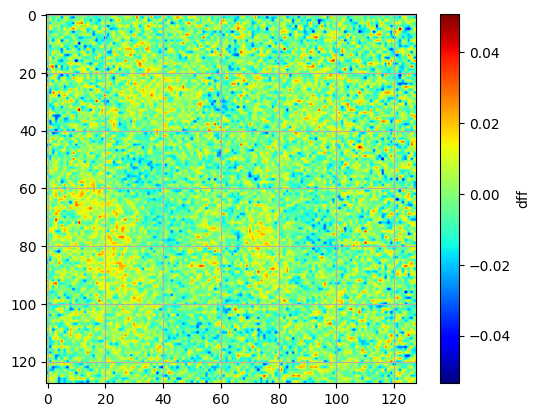

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:43,  2.90it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:41,  3.03it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:38,  3.26it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:36,  3.40it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:36,  3.37it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:35,  3.43it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:34,  3.48it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:38,  3.15it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:40,  2.97it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:38,  3.05it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:37,  3.16it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:37,  3.11it/s]

 10%|████████▏                                                                        | 13/128 [00:04<00:36,  3.19it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:34,  3.34it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:33,  3.36it/s]

 12%|██████████▏                                                                      | 16/128 [00:05<00:36,  3.09it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:36,  3.04it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:34,  3.16it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:35,  3.10it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:35,  3.06it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:34,  3.13it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:33,  3.16it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:31,  3.30it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:33,  3.11it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:32,  3.16it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:31,  3.22it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:29,  3.40it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:28,  3.53it/s]

 23%|██████████████████▎                                                              | 29/128 [00:08<00:28,  3.46it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:28,  3.41it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:29,  3.33it/s]

 25%|████████████████████▎                                                            | 32/128 [00:09<00:30,  3.18it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:29,  3.27it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:28,  3.26it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:29,  3.15it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:11<00:28,  3.19it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:28,  3.17it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:29,  3.08it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:12<00:28,  3.14it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:28,  3.04it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:12<00:27,  3.14it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:13<00:26,  3.26it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:25,  3.33it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:13<00:25,  3.31it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:13<00:25,  3.30it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:14<00:24,  3.30it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:25,  3.20it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:14<00:26,  3.04it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:15<00:26,  3.03it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:24,  3.19it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:15<00:23,  3.27it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:16<00:23,  3.28it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:16<00:22,  3.31it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:16<00:22,  3.27it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:17<00:21,  3.38it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:22,  3.18it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:21,  3.30it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:18<00:21,  3.29it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:18<00:22,  3.11it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:20,  3.24it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:18<00:19,  3.39it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:19<00:20,  3.30it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:19<00:19,  3.39it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:19<00:18,  3.37it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:20<00:18,  3.32it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:20<00:18,  3.38it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:20<00:18,  3.36it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:21<00:18,  3.32it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:21<00:17,  3.42it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:17,  3.41it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:21<00:16,  3.38it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:22<00:17,  3.24it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:16,  3.32it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:22<00:16,  3.30it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:23<00:16,  3.26it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:23<00:16,  3.16it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:23<00:15,  3.27it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:24<00:15,  3.26it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:24<00:15,  3.22it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:24<00:15,  3.13it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:25<00:14,  3.17it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:25<00:14,  3.10it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:25<00:14,  3.16it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:25<00:13,  3.17it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:26<00:13,  3.25it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:26<00:13,  3.18it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:26<00:12,  3.27it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:27<00:12,  3.15it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:27<00:12,  3.01it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:27<00:11,  3.17it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:28<00:11,  3.31it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:28<00:11,  3.21it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:28<00:10,  3.24it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:29<00:10,  3.16it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:29<00:10,  3.14it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:29<00:10,  3.11it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:30<00:09,  3.16it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:30<00:09,  3.15it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:30<00:08,  3.28it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:31<00:09,  3.08it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:31<00:09,  2.89it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:31<00:09,  2.87it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:32<00:08,  2.81it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:32<00:09,  2.63it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:32<00:08,  2.70it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:33<00:08,  2.71it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:33<00:07,  2.65it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:34<00:07,  2.65it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:34<00:07,  2.69it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:34<00:06,  2.68it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:35<00:06,  2.75it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:35<00:05,  2.68it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:35<00:05,  2.71it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:36<00:04,  2.86it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:36<00:04,  2.86it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:36<00:04,  2.88it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:37<00:03,  2.90it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:37<00:03,  2.92it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:37<00:02,  3.06it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:38<00:02,  3.02it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:38<00:02,  3.03it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:38<00:01,  3.20it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:39<00:01,  3.17it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:39<00:01,  3.18it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:39<00:00,  3.35it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:40<00:00,  3.27it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:40<00:00,  3.24it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:40<00:00,  3.29it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:40<00:00,  3.15it/s]

frame number 200 plotted


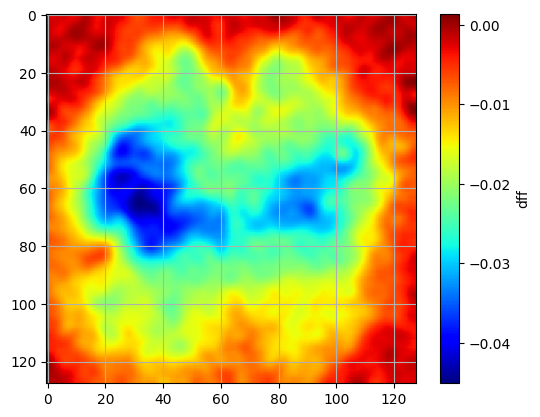

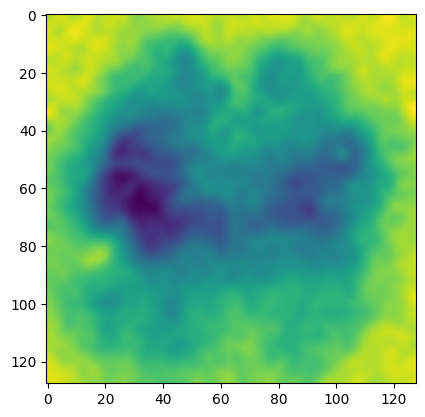

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

Segment single length mismatch: expected 200, got 0 at index 10


In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 14


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 36
fail = 0
total trials = 36


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 49
fail = 1
total trials = 50


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 0
fail = 14
total trials = 14


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34584 [00:00<?, ?it/s]

  8%|██████                                                                    | 2829/34584 [00:00<00:01, 28020.13it/s]

 16%|████████████                                                              | 5632/34584 [00:00<00:01, 26776.97it/s]

 24%|██████████████████                                                        | 8423/34584 [00:00<00:00, 27164.15it/s]

 32%|███████████████████████▌                                                 | 11143/34584 [00:00<00:00, 25689.81it/s]

 40%|████████████████████████████▉                                            | 13723/34584 [00:00<00:00, 25642.84it/s]

 47%|██████████████████████████████████▍                                      | 16294/34584 [00:00<00:00, 25172.17it/s]

 55%|███████████████████████████████████████▉                                 | 18894/34584 [00:00<00:00, 25356.04it/s]

 62%|█████████████████████████████████████████████▏                           | 21434/34584 [00:00<00:00, 24834.12it/s]

 70%|███████████████████████████████████████████████████                      | 24201/34584 [00:00<00:00, 25616.74it/s]

 78%|████████████████████████████████████████████████████████▊                | 26926/34584 [00:01<00:00, 26091.14it/s]

 86%|██████████████████████████████████████████████████████████████▋          | 29682/34584 [00:01<00:00, 26456.01it/s]

 94%|████████████████████████████████████████████████████████████████████▌    | 32511/34584 [00:01<00:00, 26928.00it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34584/34584 [00:01<00:00, 25736.64it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25002.56it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 20005.27it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")